# Selected 'Statistical Rethinking' examples using CmdStanPy

This notebook attempts to reproduce the analysis for some of the examples covered throughout the book 'Statistical Rethinking' 2nd Ed. by Richard McElreath using CmdStanPy. 

Statistical Rethinking site: https://xcelab.net/rm/statistical-rethinking/

Data: https://github.com/rmcelreath/rethinking/tree/master/data

See also:
- https://mc-stan.org/docs/2_26/stan-users-guide/index.html
- https://vincentarelbundock.github.io/rethinking2/
- https://bebi103b.github.io/index.html
   - in particular: 
      - https://bebi103b.github.io/lessons/13/prior_predictive_checks.html
      - https://bebi103b.github.io/lessons/14/posterior_predictive_checks.html

## Setup

**cmdstanpy:** I had a bit of trouble at first getting the cmdstanpy model compiler to work on my mac. But I found the following steps worked, which involved setting the compiler flag to clang.

**arviz:** ArViz is a package for working with the data generated by stan. It includes useful diagnostic plotting functions.

**altair:** Altair is a plotting package that I've grown fond of. It feels more intuitive and elegant than matplotlib.

In [ ]:
# I had to do the following to get the model to compile...a one-time thing.
# os.environ["CXX"] = "clang++" # always needed
# cmdstanpy.install_cmdstan()
# cmdstanpy.cmdstan_path()

In [77]:
import os
os.environ["CXX"] = "clang++"

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import altair as alt
alt.data_transformers.disable_max_rows()
alt.renderers.enable('jupyterlab')

import arviz as az

from scipy import stats
from sklearn.linear_model import LinearRegression

import cmdstanpy

## Chapter 4.3: Gaussian Model of Height

### Data

In [78]:
# this is the dataset used in Ch. 4 of Statistical Rethinking.
data_df = pd.read_csv('https://raw.githubusercontent.com/rmcelreath/rethinking/master/data/Howell1.csv', sep=';')
data_df = data_df[data_df.age>=18] # select adults
heights = data_df.height.values

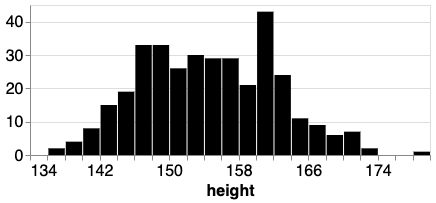

In [79]:
alt.Chart(data_df).mark_bar(color='black').encode(
    alt.X('height', bin=alt.Bin(maxbins=30, extent=[135, 180]),
            title='height'),
    alt.Y('count()', title=None),
).properties(
    width=400,
    height=150
).configure_axis(
        labelFontSize=16,
        titleFontSize=16
)

### Prior predictive checks

CmdStanPy reads the model code from a file on disk, so we first define it, then save it as a file.

In [80]:
model_file = "./stan_artifacts/model_height_prior_check.stan"

For the prior predictive check, we're not working with actual observed data, but simply simulating from the likelihood and prior. But we still pass in a data block that encodes the parameters.

The generated quantities block is for drawing samples from distributions. We could do this step -- the prior predictive check -- using other tools like scipy, but I prefer doing all of the modeling steps under the unified umbrella of stan.

In the following, we're telling stan to generate N_ppc samples for height, for each draw of mu and sigma. Taking N_ppc=100, that means 100 * 1000 distinct values (iter_sampling=1000 in the sample method call below).

**NOTE:** For sigma, I'm using a broad lognormal distribution rather than a uniform dist (which is used in the text). The uniform works for most of the steps below, but I found for the MLE optimization, it had trouble converging on the MLE sigma starting with a uniform prior, whereas the smooth lognormal prior behaved better.

In [81]:
model_code = """
data {
  int<lower=1> N_ppc;
  real mu_loc;
  real mu_scale;
  real sigma_loc;
  real sigma_scale;
}

generated quantities {
  real mu;
  real<lower=0> sigma;
  real height[N_ppc];
  
  mu = normal_rng(mu_loc, mu_scale);
  sigma = lognormal_rng(sigma_loc, sigma_scale);
  
  for (i in 1:N_ppc) {
    height[i] = normal_rng(mu, sigma);
  }
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [82]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height_prior_check
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height_prior_check
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height_prior_check


In [83]:
data = {
    'N_ppc':100,
    'mu_loc':178,
    'mu_scale':20,
    'sigma_loc':1,
    'sigma_scale':1
}

In [84]:
fit_prior = stan_model.sample(data=data, iter_sampling=1000, fixed_param=True) # NOTE: these aren't needed for the ppc: chains=1, iter_warmup=0)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:finish chain 1


In [85]:
azdata = az.from_cmdstanpy(
    prior=fit_prior, 
    prior_predictive=['height']
)
samp_priors_df = azdata.prior.to_dataframe().reset_index()
samp_prior_pred_df = azdata.prior_predictive.to_dataframe().reset_index()

In [86]:
az.summary(azdata)

arviz - WARNING - Shape validation failed: input_shape: (1, 1000), minimum_shape: (chains=2, draws=4)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
mu,178.828,20.051,145.081,219.294,0.672,0.476,889.0,889.0,901.0,948.0,NaN
sigma,4.604,6.165,0.161,12.932,0.200,0.141,950.0,950.0,841.0,1005.0,NaN


In [87]:
# there are 1000 draws of (mu, sigma)
print(samp_priors_df.shape)
samp_priors_df.head()

(1000, 4)


,chain,draw,mu,sigma
0,0,0,155.773,5.194650
1,0,1,169.018,0.760464
2,0,2,196.668,3.580830
3,0,3,183.657,0.553188
4,0,4,184.562,1.792040


In [88]:
# there are 100,000 distinct values for height (100 for each draw of mu,sigma)
print(samp_prior_pred_df.shape)
samp_prior_pred_df.head()

(100000, 4)


,chain,draw,height_dim_0,height
0,0,0,0,155.143
1,0,0,1,158.190
2,0,0,2,162.438
3,0,0,3,160.379
4,0,0,4,149.308


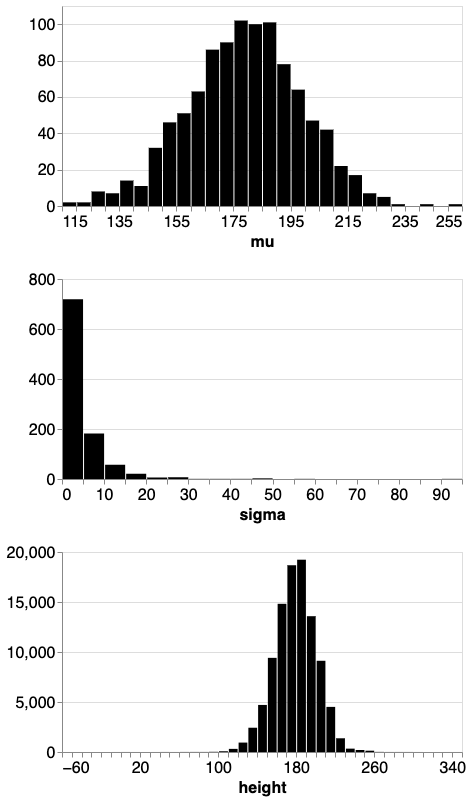

In [89]:
w=400
h=200

chart_mu = alt.Chart(samp_priors_df).mark_bar(color='black').encode(
    alt.X('mu', bin=alt.Bin(maxbins=30), title='mu'),
    alt.Y('count()', title=None),
).properties(
    width=w,
    height=h
)

chart_sigma = alt.Chart(samp_priors_df).mark_bar(color='black').encode(
    alt.X('sigma', bin=alt.Bin(maxbins=30), title='sigma'),
    alt.Y('count()', title=None),
).properties(
    width=w,
    height=h
)

chart_height = alt.Chart(samp_prior_pred_df).mark_bar(color='black').encode(
    alt.X('height', bin=alt.Bin(maxbins=50), title='height'),
    alt.Y('count()', title=None),
).properties(
    width=w,
    height=h
)

alt.vconcat(chart_mu, chart_sigma, chart_height).configure_axis(
    labelFontSize=16,
    titleFontSize=16
)

### Fitting the posterior

In [14]:
model_file = "./stan_artifacts/model_height.stan"

In [15]:
model_code = """
data {
  int<lower=1> N_obs;
  int<lower=1> N_ppc;
  real height[N_obs];
}
parameters {
  real mu;
  real<lower=0> sigma;
}
model {
  mu ~ normal(178, 20);
  sigma ~ lognormal(1, 1);
  height ~ normal(mu, sigma);
}
generated quantities {
  real height_ppc[N_ppc];  
  for (i in 1:N_ppc) {
    height_ppc[i] = normal_rng(mu, sigma);
  }
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [16]:
data = {
    'N_obs':len(heights),
    'N_ppc':100,
    'height':heights
}

In [17]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height


In [18]:
fit = stan_model.sample(data=data, iter_sampling=1000, iter_warmup=1000, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 4
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 3


In [19]:
azdata = az.from_cmdstanpy(
    posterior=fit, 
    posterior_predictive=['height_ppc'],
    observed_data={"height": data["height"]}
)
samp_post_df = azdata.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata.posterior_predictive.to_dataframe().reset_index()

In [20]:
az.summary(azdata)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
mu,154.611,0.413,153.865,155.432,0.007,0.005,3356.0,3356.0,3369.0,2610.0,1.0
sigma,7.750,0.293,7.234,8.313,0.005,0.004,3328.0,3301.0,3365.0,2499.0,1.0


In [21]:
# there are 4*1000 draws of mu, sigma
print(samp_post_df.shape)
samp_post_df.head()

(4000, 4)


,chain,draw,mu,sigma
0,0,0,154.722,7.79339
1,0,1,154.344,7.94829
2,0,2,154.843,7.51896
3,0,3,154.310,7.97369
4,0,4,154.445,7.66267


In [22]:
# there are 4*1000*100 sampled values of height
print(samp_post_pred_df.shape)
samp_post_pred_df.head()

(400000, 4)


,chain,draw,height_ppc_dim_0,height_ppc
0,0,0,0,152.185
1,0,0,1,146.102
2,0,0,2,151.921
3,0,0,3,151.260
4,0,0,4,150.949


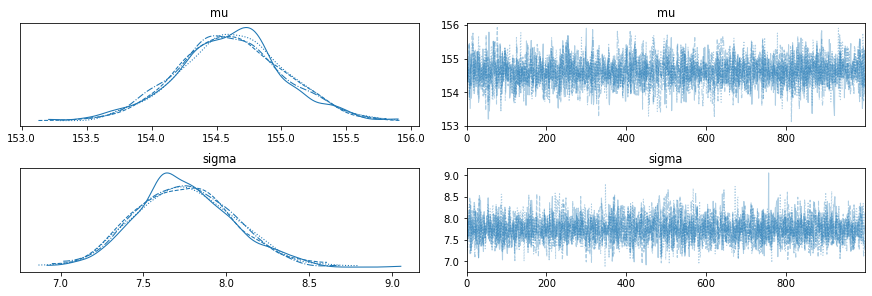

In [23]:
az.plot_trace(azdata)

plt.show()

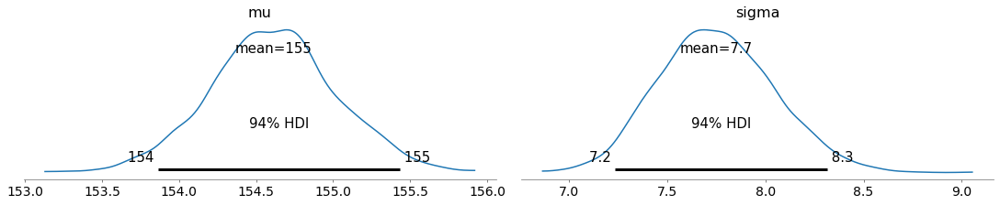

In [24]:
az.plot_posterior(azdata, figsize=[15, 3])

plt.show()

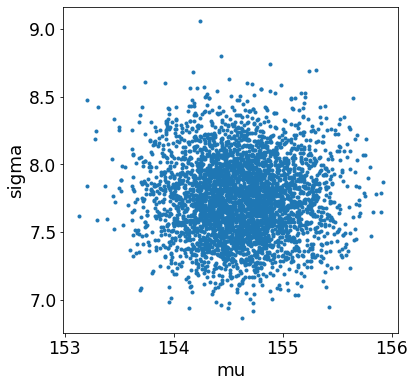

In [25]:
az.plot_pair(azdata, var_names=['mu', 'sigma'], kind='scatter', figsize=(6, 6))

plt.show()

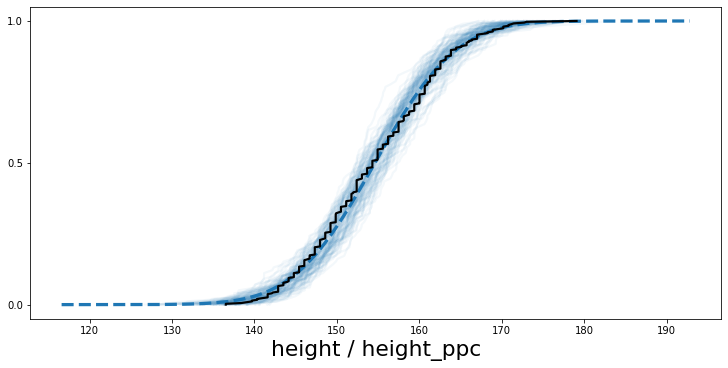

In [26]:
az.plot_ppc(azdata, kind='cumulative', data_pairs={'height':'height_ppc'}, alpha=0.05, figsize=(10, 5), legend=False, num_pp_samples=100)

plt.show()

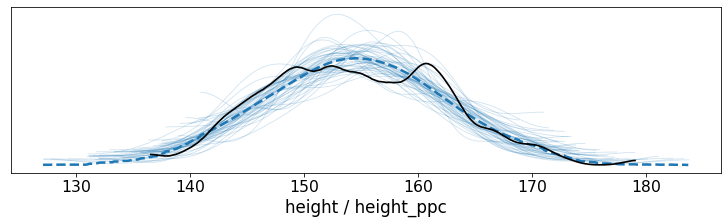

In [27]:
az.plot_ppc(azdata, data_pairs={'height':'height_ppc'}, alpha=0.2, figsize=(10, 3), legend=False, num_pp_samples=50)

plt.show()

## Chapter 4.4: Linear Prediction

### Data

In [116]:
# this is the dataset used in Ch. 4 of Statistical Rethinking.
data_df = pd.read_csv('https://raw.githubusercontent.com/rmcelreath/rethinking/master/data/Howell1.csv', sep=';')
data_df = data_df[data_df.age>=18] # select adults
heights = data_df.height.values
weights = data_df.weight.values

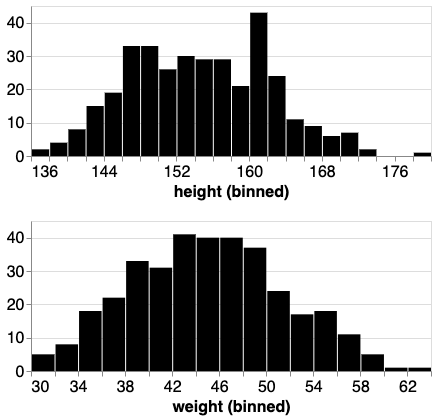

In [117]:
h=alt.Chart(data_df).mark_bar(color='black').encode(
    alt.X('height', bin=alt.Bin(maxbins=30)),
    alt.Y('count()', title=None),
).properties(
    width=400,
    height=150
)

w=alt.Chart(data_df).mark_bar(color='black').encode(
    alt.X('weight', bin=alt.Bin(maxbins=30)),
    alt.Y('count()', title=None),
).properties(
    width=400,
    height=150
)
    
alt.vconcat(h, w).configure_axis(
        labelFontSize=16,
        titleFontSize=16
)

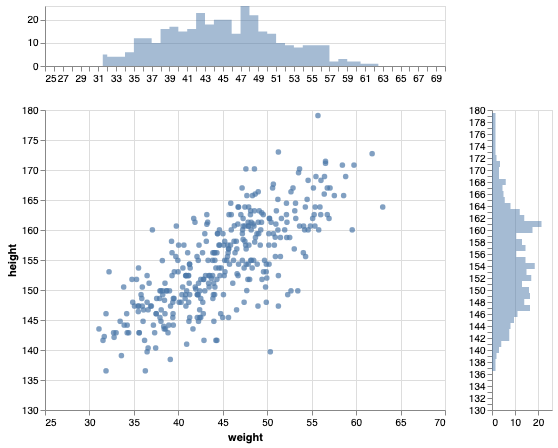

In [118]:
base = alt.Chart(data_df)

xscale = alt.Scale(domain=(25, 70))
yscale = alt.Scale(domain=(130, 180))

area_args = {'opacity': .5, 'interpolate': 'step'}

points = base.mark_circle().encode(
    alt.X('weight', scale=xscale),
    alt.Y('height', scale=yscale)
)

top_hist = base.mark_area(**area_args).encode(
    alt.X('weight:Q',
          bin=alt.Bin(maxbins=50, extent=xscale.domain),
          stack=None,
          title=''
         ),
    alt.Y('count()', stack=None, title='')
).properties(height=60)

right_hist = base.mark_area(**area_args).encode(
    alt.Y('height:Q',
          bin=alt.Bin(maxbins=50, extent=yscale.domain),
          stack=None,
          title='',
         ),
    alt.X('count()', stack=None, title='')
).properties(width=60)

top_hist & (points | right_hist)

### Prior predictive checks

In [119]:
model_file = "./stan_artifacts/model_ht_wt_prior_check.stan"

For our prior predictive check, we pass in a set of linearly spaced weights that span the expected range of values. We have to do this since we don't have the observed data at this stage in the model building. An alternative would be to sample weight from a gaussian (with an appropriate choice of mean and variance), which could be encoded in stan as well.

In [120]:
w_mean = data_df.weight.mean()
w_std = data_df.weight.std()
w_ppc = list(range(30, 72, 2))

(round(w_mean, 2), round(w_std, 2))

(44.99, 6.46)

Note that we are shifting weight by the mean value, as is done in 'Statistical Rethinking', i.e.

mu = a + b*(w - w_loc)

In [121]:
model_code = """
data {
  int<lower=1> Nw_ppc; // number of weight values
  int<lower=1> Nh_ppc; // number of height values to sample
  vector[Nw_ppc] w;
  real w_loc;
  real a_loc;
  real a_scale;
  real b_loc;
  real b_scale;
  real sigma_loc;
  real sigma_scale;
}

generated quantities {
  real a;
  real<lower=0> b;
  real<lower=0,upper=50> sigma;
  real height[Nh_ppc, Nw_ppc];
  
  a = normal_rng(a_loc, a_scale);
  b = lognormal_rng(b_loc, b_scale);
  sigma = lognormal_rng(sigma_loc, sigma_scale);
  
  for (i in 1:Nh_ppc) {
    height[i] = normal_rng(a + b*(w - w_loc), sigma);
  }  
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [122]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_ht_wt_prior_check
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_ht_wt_prior_check
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_ht_wt_prior_check


In [123]:
data = {
    'Nh_ppc':50,
    'Nw_ppc':len(w_ppc),
    'w':w_ppc,
    'w_loc':w_mean,
    'a_loc':178,
    'a_scale':20,
    'b_loc':0,
    'b_scale':1,
    'sigma_loc':1,
    'sigma_scale':1
}

In [124]:
len(w_ppc)

21

In [125]:
fit_prior = stan_model.sample(data=data, iter_sampling=100, fixed_param=True) # NOTE: these aren't needed: chains=1, iter_warmup=0)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:finish chain 1


In [126]:
azdata = az.from_cmdstanpy(
    prior=fit_prior, 
    prior_predictive=['height'],
    observed_data=data
)
samp_priors_df = azdata.prior.to_dataframe().reset_index()

# for the prior predictive check, we're joining in all of the samples to have a complete
# dataset to work with
samp_prior_pred_df = azdata.prior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'weight':w_ppc})
temp['height_dim_1'] = temp.index.values
samp_prior_pred_df = pd.merge(samp_prior_pred_df, temp, how='left', on='height_dim_1')
samp_prior_pred_df = pd.merge(samp_prior_pred_df, samp_priors_df, how='left', on=['chain', 'draw'])

In [127]:
az.summary(azdata)

arviz - WARNING - Shape validation failed: input_shape: (1, 100), minimum_shape: (chains=2, draws=4)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,179.091,19.137,152.224,216.530,2.764,1.966,48.0,48.0,44.0,112.0,NaN
b,1.480,1.476,0.096,3.876,0.172,0.122,74.0,74.0,80.0,112.0,NaN
sigma,4.040,3.388,0.307,9.946,0.332,0.238,104.0,102.0,81.0,78.0,NaN


In [128]:
# there are 100 draws of a,b,sigma
print(samp_priors_df.shape)
samp_priors_df.head()

(100, 5)


,chain,draw,a,b,sigma
0,0,0,142.981,2.344130,1.434730
1,0,1,190.988,0.591911,4.971220
2,0,2,152.224,1.203660,0.564135
3,0,3,170.017,0.623042,1.271400
4,0,4,185.845,1.781070,3.136930


In [129]:
# there are 100*50*len(w_ppc) values of height
print(samp_prior_pred_df.shape)
samp_prior_pred_df.head()

(105000, 9)


,chain,draw,height_dim_0,height_dim_1,height,weight,a,b,sigma
0,0,0,0,0,108.389,30,142.981,2.34413,1.43473
1,0,0,0,1,110.688,32,142.981,2.34413,1.43473
2,0,0,0,2,117.071,34,142.981,2.34413,1.43473
3,0,0,0,3,121.808,36,142.981,2.34413,1.43473
4,0,0,0,4,123.962,38,142.981,2.34413,1.43473


We're following along with the analysis in 'Statistical Rethinking', where he does a check of the simulated lines implied by the priors for a and b. Below, we show two different approaches to inspecting these lines. 

In the first, we calculated, for each pair of a and b, and each value of weight, the mean of the height, then we plot that height vs weight as a line -- one line for each pair of a and b.

In the second (which is what is done in 'Stat. Rethinking'), we calculate the height based solely on the linear model in the prior: h = a + b(w - w_mean). These lines are perfectly strait, of course, while the lines in the first approach have variation due to sampling. 

We also plot the raw values of height to show the effect of sigma.

In [130]:
lines_df = samp_prior_pred_df.groupby(['chain', 'draw', 'height_dim_1']).mean().reset_index().rename(
    {'height':'height_mean'}, axis=1).drop(['height_dim_0'], axis=1)
lines_df['height_std'] = samp_prior_pred_df.groupby(['chain', 'draw', 'height_dim_1']).height.std().values
lines_df['height_mu'] = lines_df.a + lines_df.b*(lines_df.weight - w_mean)

In [131]:
lines_df.head()

,chain,draw,height_dim_1,height_mean,weight,a,b,sigma,height_std,height_mu
0,0,0,0,107.66572,30.0,142.981,2.34413,1.43473,1.802229,107.841353
1,0,0,1,112.56172,32.0,142.981,2.34413,1.43473,1.356602,112.529613
2,0,0,2,117.49118,34.0,142.981,2.34413,1.43473,1.195424,117.217873
3,0,0,3,121.72398,36.0,142.981,2.34413,1.43473,1.543194,121.906133
4,0,0,4,126.59606,38.0,142.981,2.34413,1.43473,1.616548,126.594393


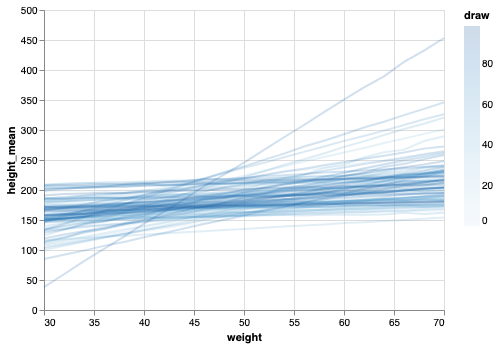

In [132]:
alt.Chart(lines_df).mark_line(opacity=0.2).encode(
    x='weight',
    y='height_mean',
    color='draw'
)

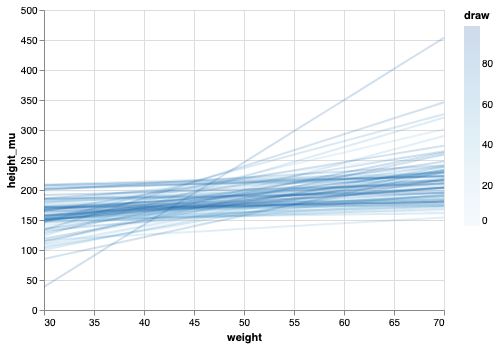

In [133]:
alt.Chart(lines_df).mark_line(opacity=0.2).encode(
    x='weight',
    y=alt.Y('height_mu'),
    color='draw'
)

In [134]:
# alt.Chart(samp_prior_pred_df).mark_circle(opacity=0.01).encode(
#     x=alt.X('weight', scale=alt.Scale(domain=[30, 70])),
#     y=alt.Y('height', scale=alt.Scale(domain=[0, 350])),
# )

Here we show the histogram of height at the value of weight = 44, which is close to the mean.

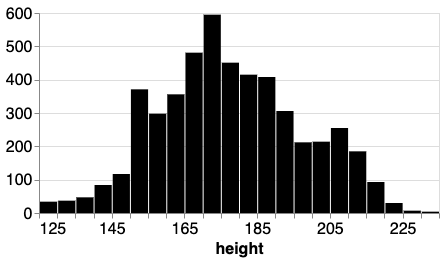

In [135]:
temp_df = samp_prior_pred_df[samp_prior_pred_df.weight==44]

chart_height = alt.Chart(temp_df).mark_bar(color='black').encode(
    alt.X('height', bin=alt.Bin(maxbins=30), title='height'),
    alt.Y('count()', title=None),
).properties(
    width=400,
    height=200
)

chart_height.configure_axis(
    labelFontSize=16,
    titleFontSize=16
)

### Fitting the posterior

#### Define the model

In [48]:
model_file = "./stan_artifacts/model_ht_wt.stan"

In [49]:
w_ppc = list(range(30, 72, 2))

In [50]:
data = {
    'N_obs':len(weights),
    'Nw_ppc':len(w_ppc),
    'Nh_ppc':50,
    'weight':weights,
    'height':heights,
    'w_ppc':w_ppc
}

In [51]:
model_code = """
data {
  int<lower=1> N_obs;
  int<lower=1> Nw_ppc;
  int<lower=1> Nh_ppc;
  vector[N_obs] height;
  vector[N_obs] weight;
  vector[Nw_ppc] w_ppc;
  
}
transformed data {
  real w_mean = mean(weight);
}
parameters {
  real a;
  real<lower=0> b;
  real<lower=0> sigma;
}
model {
  a ~ normal(178, 20);
  b ~ lognormal(0, 1);
  sigma ~ lognormal(1, 1);
  height ~ normal(a + b * (weight - w_mean), sigma);
}
generated quantities {
  real height_ppc[Nh_ppc, Nw_ppc];
  for (i in 1:Nh_ppc) {
    height_ppc[i] = normal_rng(a + b*(w_ppc - w_mean), sigma);
  }
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [52]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_ht_wt
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_ht_wt
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_ht_wt


#### MLE optimization check

In [53]:
fit_mle = stan_model.optimize(data=data)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:finish chain 1


In [54]:
fit_mle.optimized_params_pd

,lp__,a,b,sigma,"height_ppc[1,1]","height_ppc[2,1]","height_ppc[3,1]","height_ppc[4,1]","height_ppc[5,1]","height_ppc[6,1]",...,"height_ppc[41,21]","height_ppc[42,21]","height_ppc[43,21]","height_ppc[44,21]","height_ppc[45,21]","height_ppc[46,21]","height_ppc[47,21]","height_ppc[48,21]","height_ppc[49,21]","height_ppc[50,21]"
0,-751.789,154.601,0.903294,5.06021,143.81,141.888,148.789,134.592,136.177,140.104,...,183.111,179.263,176.3,176.965,178.411,177.879,179.823,180.206,183.503,188.473


Compare this with what we would have obtained via a least squares fit:

In [55]:
x = np.transpose(np.array([weights]))
x = x-np.mean(x)
y = heights
fit_lr = LinearRegression().fit(x, y)

In [56]:
(fit_lr.intercept_, fit_lr.coef_[0])

(154.5970926136364, 0.905029108626648)

In [57]:
w = np.arange(25, 71, 1)
a = fit_mle.optimized_params_dict['a']
b = fit_mle.optimized_params_dict['b']
wmean = data_df.weight.mean()
h = a + b*(w - wmean)

mle_df = pd.DataFrame({'weight':w, 'height':h})

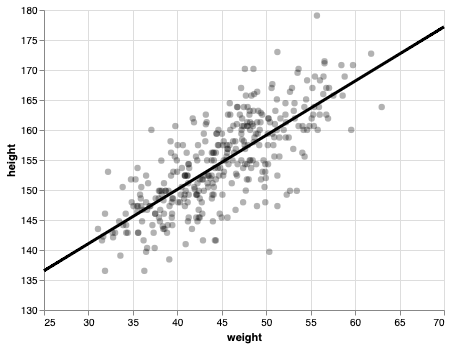

In [58]:
xscale = alt.Scale(domain=(25, 70))
yscale = alt.Scale(domain=(130, 180))

points = alt.Chart(data_df).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('weight', scale=xscale),
    alt.Y('height', scale=yscale)
)

line = alt.Chart(mle_df).mark_line(size=3, color='black').encode(
    alt.X('weight', scale=xscale),
    alt.Y('height', scale=yscale)
)

points + line

#### MCMC fit

In [59]:
fit = stan_model.sample(data=data, iter_sampling=500, iter_warmup=500, chains=2)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2


In [60]:
azdata = az.from_cmdstanpy(
    posterior=fit, 
    posterior_predictive=['height_ppc'],
    observed_data={'weight': weights, 'height': heights}
)

In [61]:
az.summary(azdata)

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,154.592,0.268,154.072,155.075,0.009,0.006,907.0,907.0,906.0,507.0,1.0
b,0.904,0.044,0.825,0.989,0.001,0.001,1121.0,1121.0,1130.0,685.0,1.0
sigma,5.091,0.185,4.755,5.423,0.006,0.004,918.0,918.0,915.0,680.0,1.0


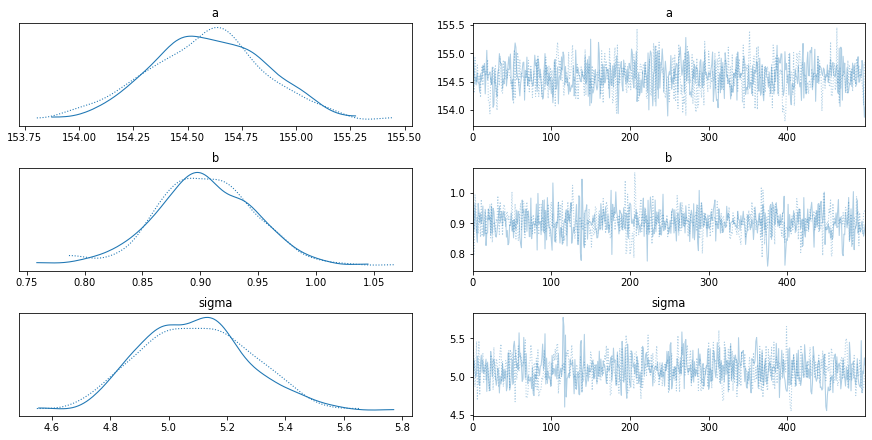

In [62]:
az.plot_trace(azdata)

plt.show()

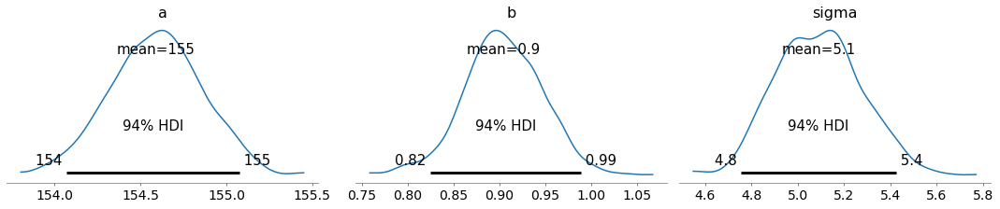

In [63]:
az.plot_posterior(azdata, figsize=[15, 3])

plt.show()

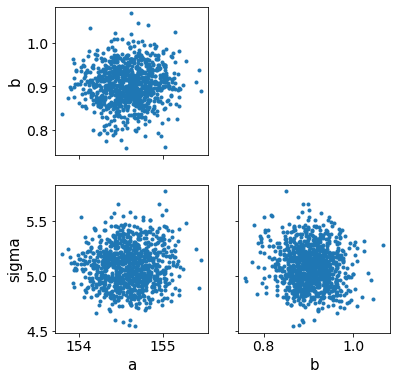

In [64]:
az.plot_pair(azdata, var_names=['a', 'b', 'sigma'], kind='scatter', figsize=(6, 6))

plt.show()

In [65]:
samp_post_df = azdata.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'weight':w_ppc})
temp['height_ppc_dim_1'] = temp.index.values
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='height_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [66]:
print(samp_post_df.shape)
samp_post_df.head()

(1000, 5)


,chain,draw,a,b,sigma
0,0,0,154.536,0.831048,4.91047
1,0,1,154.960,0.943272,5.09468
2,0,2,154.725,0.878078,5.21412
3,0,3,154.446,0.964350,5.07168
4,0,4,154.581,0.916487,4.99159


In [67]:
print(samp_post_pred_df.shape)
samp_post_pred_df.head()

(1050000, 9)


,chain,draw,height_ppc_dim_0,height_ppc_dim_1,height_ppc,weight,a,b,sigma
0,0,0,0,0,140.366,30,154.536,0.831048,4.91047
1,0,0,0,1,144.659,32,154.536,0.831048,4.91047
2,0,0,0,2,148.971,34,154.536,0.831048,4.91047
3,0,0,0,3,141.072,36,154.536,0.831048,4.91047
4,0,0,0,4,145.044,38,154.536,0.831048,4.91047


In [68]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'height_ppc_dim_1']).mean().reset_index().rename({'height_ppc':'height_ppc_mean'}, axis=1)
lines_df['height_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'height_ppc_dim_1']).height_ppc.std().values
lines_df['height_ppc_mu'] = lines_df.a + lines_df.b*(lines_df.weight - w_mean)

In [69]:
lines_df.head()

,chain,draw,height_ppc_dim_1,height_ppc_dim_0,height_ppc_mean,weight,a,b,sigma,height_ppc_std,height_ppc_mu
0,0,0,0,24.5,141.64378,30.0,154.536,0.831048,4.91047,4.687502,142.078187
1,0,0,1,24.5,143.44544,32.0,154.536,0.831048,4.91047,4.109510,143.740283
2,0,0,2,24.5,144.87860,34.0,154.536,0.831048,4.91047,4.908874,145.402379
3,0,0,3,24.5,147.00888,36.0,154.536,0.831048,4.91047,4.722888,147.064475
4,0,0,4,24.5,149.30758,38.0,154.536,0.831048,4.91047,5.108572,148.726571


As we would expect, after calculating the posterior for a and b based on observed data, we find a much tighter spread of lines that we saw with the prior above.

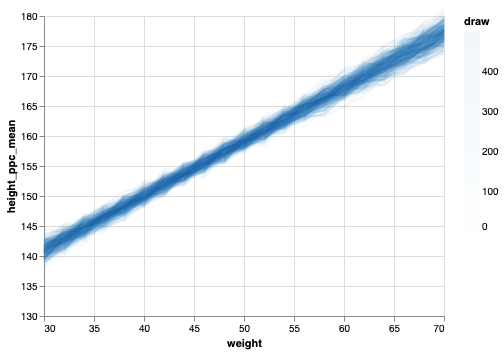

In [70]:
temp = lines_df[lines_df.chain==0]
# temp = lines_df[(lines_df.chain==0) & (lines_df.draw==2)]

alt.Chart(temp).mark_line(opacity=0.05).encode(
    x='weight',
    y=alt.Y('height_ppc_mean', scale=alt.Scale(domain=[130, 180])),
    color='draw'
)

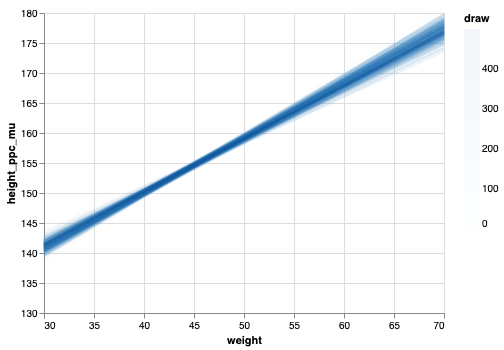

In [71]:
alt.Chart(temp).mark_line(opacity=0.05).encode(
    x='weight',
    y=alt.Y('height_ppc_mu', scale=alt.Scale(domain=[130, 180])),
    color='draw'
)

Here we show a histogram of mu values, which again has a much smaller variation than we saw above with the prior check. Note, this is not the actual predicted spread of heights that includes the effect of sigma (we show that below).

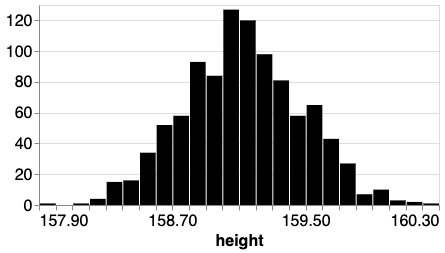

In [72]:
temp_df = lines_df[lines_df.weight==50]

chart_height = alt.Chart(temp_df).mark_bar(color='black').encode(
    alt.X('height_ppc_mu', bin=alt.Bin(maxbins=30), title='height'),
    alt.Y('count()', title=None),
).properties(
    width=400,
    height=200
)

chart_height.configure_axis(
    labelFontSize=16,
    titleFontSize=16
)

To show the full posterior predictive on height, which includes the effect of uncertainty encoded by sigma, we calculate the mean value of height for each weight, as well as the upper and lower values (using the same quantiles as in 'Statistical Rethinking' for an 89% interval). 

In [73]:
temp = samp_post_pred_df.groupby('weight').mean().reset_index()
temp['h_lower'] = samp_post_pred_df.groupby('weight').height_ppc.quantile(0.055).values
temp['h_upper'] = samp_post_pred_df.groupby('weight').height_ppc.quantile(0.945).values
temp.head()

,weight,chain,draw,height_ppc_dim_0,height_ppc_dim_1,height_ppc,a,b,sigma,h_lower,h_upper
0,30,0.5,249.5,24.5,0.0,141.030752,154.592341,0.904094,5.091289,132.88600,149.243110
1,32,0.5,249.5,24.5,1.0,142.778070,154.592341,0.904094,5.091289,134.58700,150.959000
2,34,0.5,249.5,24.5,2.0,144.635048,154.592341,0.904094,5.091289,136.42578,152.782000
3,36,0.5,249.5,24.5,3.0,146.470271,154.592341,0.904094,5.091289,138.31400,154.633110
4,38,0.5,249.5,24.5,4.0,148.218321,154.592341,0.904094,5.091289,140.09900,156.364055


This plot shows the mean value of height and the shaded region is the 89% interval.

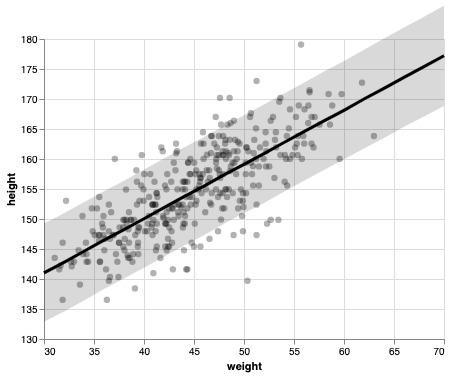

In [74]:
xscale = alt.Scale(domain=(30, 70))
yscale = alt.Scale(domain=(130, 180))

points = alt.Chart(data_df).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('weight', scale=xscale),
    alt.Y('height', scale=yscale, title='height')
)

line = alt.Chart(temp).mark_line(size=3, color='black').encode(
    x=alt.X('weight', scale=alt.Scale(domain=[30, 70])),
    y=alt.Y('height_ppc', scale=alt.Scale(domain=[130, 180])),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='weight:Q',
    y='h_lower:Q',
    y2='h_upper:Q'
)

points+area+line

In [76]:
temp_df = samp_post_pred_df[samp_post_pred_df.weight==50]

chart_height = alt.Chart(temp_df).mark_bar(color='black').encode(
    alt.X('height_ppc', bin=alt.Bin(maxbins=50), title='height'),
    alt.Y('count()', title=None),
).properties(
    width=400,
    height=200
)

chart_height.configure_axis(
    labelFontSize=16,
    titleFontSize=16
)

## Chapter 5.1: Spurious Association

### Data

In [753]:
data_df = pd.read_csv('https://raw.githubusercontent.com/rmcelreath/rethinking/master/data/WaffleDivorce.csv', sep=';')
data_df = data_df[['Location', 'MedianAgeMarriage', 'Marriage', 'Divorce']].copy()
# define standardized variables
data_df["A"] = data_df.MedianAgeMarriage.pipe(lambda x: (x - x.mean()) / x.std())
data_df["M"] = data_df.Marriage.pipe(lambda x: (x - x.mean()) / x.std())
data_df["D"] = data_df.Divorce.pipe(lambda x: (x - x.mean()) / x.std())
data_df.head()

,Location,MedianAgeMarriage,Marriage,Divorce,A,M,D
0,Alabama,25.3,20.2,12.7,-0.606290,0.022644,1.654205
1,Alaska,25.2,26.0,12.5,-0.686699,1.549802,1.544364
2,Arizona,25.8,20.3,10.8,-0.204241,0.048974,0.610716
3,Arkansas,24.3,26.4,13.5,-1.410387,1.655123,2.093569
4,California,26.8,19.1,8.0,0.599857,-0.266989,-0.927058


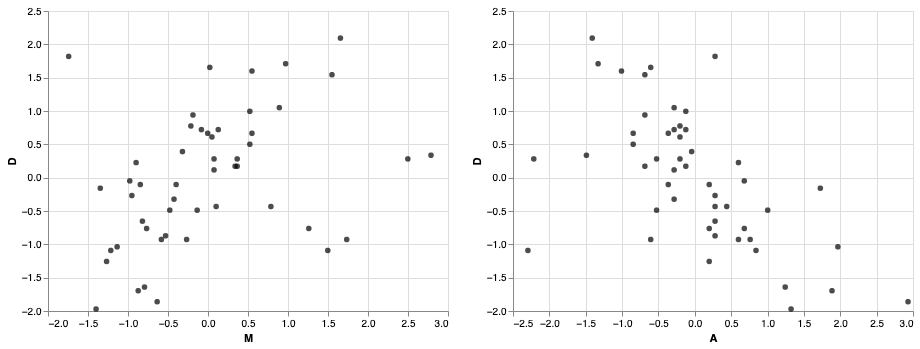

In [754]:
base = alt.Chart(data_df)

mark_args = {'color':'black'}

c1 = base.mark_circle(**mark_args).encode(
    alt.X('M'),
    alt.Y('D')
)

c2 = base.mark_circle(**mark_args).encode(
    alt.X('A'),
    alt.Y('D')
)

alt.hconcat(
c1, c2
)

### Prior predictive checks

We'll do a check on the regression lines implied by our choice of priors, for a single predictor regression.

In [755]:
model_file = "./stan_artifacts/model_divorce_prior_check.stan"

In [756]:
model_code = """
data {
  int<lower=1> Nx_ppc; // number of x values
  int<lower=1> Ny_ppc; // number of y values to sample
  vector[Nx_ppc] x;
  real a_loc;
  real a_scale;
  real b_loc;
  real b_scale;
  real sigma_rate;
}

generated quantities {
  real a;
  real b;
  real<lower=0> sigma;
  real y[Ny_ppc, Nx_ppc];
  
  a = normal_rng(a_loc, a_scale);
  b = normal_rng(b_loc, b_scale);
  sigma = exponential_rng(sigma_rate);
  
  for (i in 1:Ny_ppc) {
    y[i] = normal_rng(a + b*x, sigma);
  }  
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [757]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_prior_check
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_prior_check
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_prior_check


In [758]:
x_ppc = np.arange(-2,2.25,.25)

data = {
    'Ny_ppc':50,
    'Nx_ppc':len(x_ppc),
    'x':x_ppc,
    'a_loc':0,
    'a_scale':0.2,
    'b_loc':0,
    'b_scale':0.5,
    'sigma_rate':1
}

In [759]:
fit_prior = stan_model.sample(data=data, iter_sampling=100, fixed_param=True)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:finish chain 1


In [760]:
azdata = az.from_cmdstanpy(
    prior=fit_prior, 
    prior_predictive=['y'],
    observed_data=data
)
samp_priors_df = azdata.prior.to_dataframe().reset_index()

# for the prior predictive check, we're joining in all of the samples to have a complete
# dataset to work with
samp_prior_pred_df = azdata.prior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':x_ppc})
temp['y_dim_1'] = temp.index.values
samp_prior_pred_df = pd.merge(samp_prior_pred_df, temp, how='left', on='y_dim_1')
samp_prior_pred_df = pd.merge(samp_prior_pred_df, samp_priors_df, how='left', on=['chain', 'draw'])

In [761]:
az.summary(azdata)

arviz - WARNING - Shape validation failed: input_shape: (1, 100), minimum_shape: (chains=2, draws=4)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,0.031,0.200,-0.303,0.428,0.021,0.015,91.0,91.0,91.0,77.0,NaN
b,0.068,0.504,-0.980,1.018,0.051,0.036,98.0,98.0,101.0,104.0,NaN
sigma,1.091,1.112,0.007,3.175,0.083,0.071,180.0,125.0,157.0,97.0,NaN


In [762]:
lines_df = samp_prior_pred_df.groupby(['chain', 'draw', 'y_dim_1']).mean().reset_index().rename(
    {'y':'y_mean'}, axis=1).drop(['y_dim_1'], axis=1)
lines_df['y_std'] = samp_prior_pred_df.groupby(['chain', 'draw', 'y_dim_1']).y.std().values
lines_df['y_mu'] = lines_df.a + lines_df.b*lines_df.x

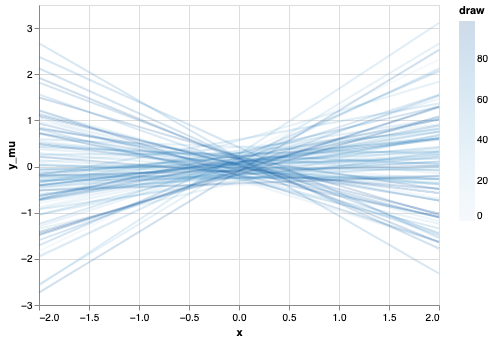

In [763]:
alt.Chart(lines_df).mark_line(opacity=0.2).encode(
    x='x',
    y=alt.Y('y_mu'),
    color='draw'
)

### Build the model

#### Define the model

We will define a model that can take any number K of predictors, then reuse it for each of the three models considered in the text.

In [764]:
model_file = "./stan_artifacts/model_divorce.stan"

In [765]:
model_code = """
data {
  int<lower=1> N_obs;        // number of observations in data
  int<lower=1> K;            // number of predictors
  int<lower=1> Nx_ppc;       // number of predictor values for ppc
  int<lower=1> Ny_ppc;       // number of samples for target in ppc
  matrix[N_obs, K] x;        // predictor matrix
  vector[N_obs] y;           // target
  matrix[Nx_ppc, K] x_ppc;   // predictor matrix for ppc
}
parameters {
  real a;                // intercept
  vector[K] b;           // coefficients for predictors
  real<lower=0> sigma;   // target uncertainty
}
model {
  a ~ normal(0, 0.2);
  b ~ normal(0, 0.5);
  sigma ~ exponential(1);
  y ~ normal(a + x * b, sigma);
}
generated quantities {
  real y_ppc[Ny_ppc, Nx_ppc];
  for (i in 1:Ny_ppc) {
    y_ppc[i] = normal_rng(a + x_ppc * b, sigma);
  }
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [766]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce


#### Model m5_1 (age as single predictor)

In [894]:
x = np.transpose([data_df.A.values]).tolist()
x_ppc = np.transpose([np.arange(-3, 3.25, 0.25)]).tolist()
y = list(data_df.D.values)

data_m5_1 = {
    'N_obs': len(data_df),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 30,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [895]:
fit_m5_1 = stan_model.sample(data=data_m5_1, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 4
INFO:cmdstanpy:finish chain 3


In [896]:
azdata_m5_1 = az.from_cmdstanpy(
    posterior = fit_m5_1, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [897]:
sum5_1 = az.summary(azdata_m5_1)
sum5_1

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.001,0.099,-0.190,0.178,0.002,0.002,2264.0,1111.0,2278.0,1455.0,1.0
b[0],-0.563,0.116,-0.784,-0.342,0.003,0.002,1763.0,1744.0,1770.0,1048.0,1.0
sigma,0.826,0.091,0.668,0.999,0.002,0.002,1925.0,1845.0,1980.0,1281.0,1.0


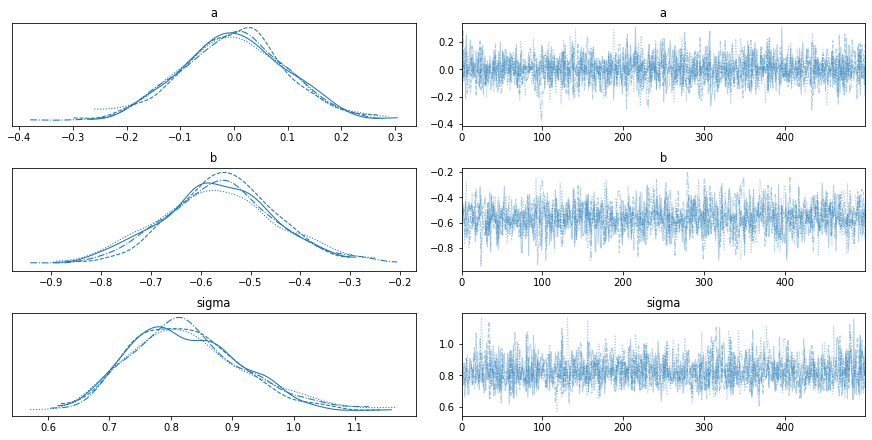

In [898]:
az.plot_trace(azdata_m5_1)

plt.show()

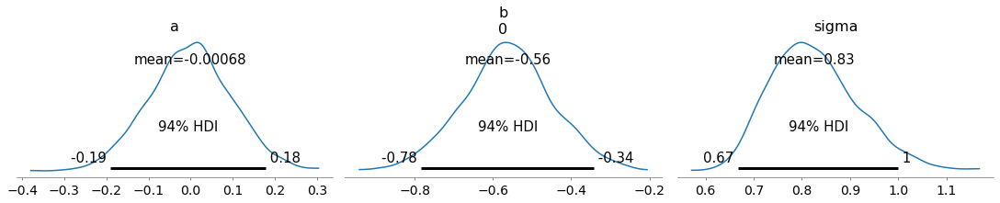

In [899]:
az.plot_posterior(azdata_m5_1, figsize=[15, 3])

plt.show()

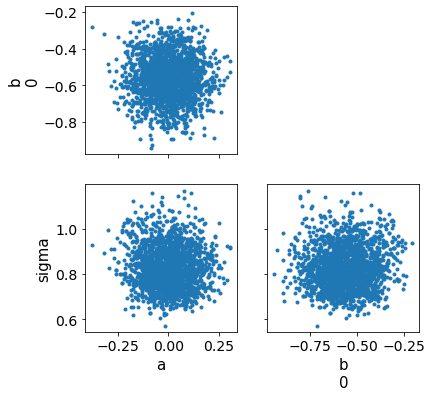

In [900]:
az.plot_pair(azdata_m5_1, var_names=['a', 'b', 'sigma'], kind='scatter', figsize=(6, 6))

plt.show()

In [901]:
samp_post_df = azdata_m5_1.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_1.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':[x[0] for x in x_ppc]})
temp['y_ppc_dim_1'] = temp.index.values
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [902]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

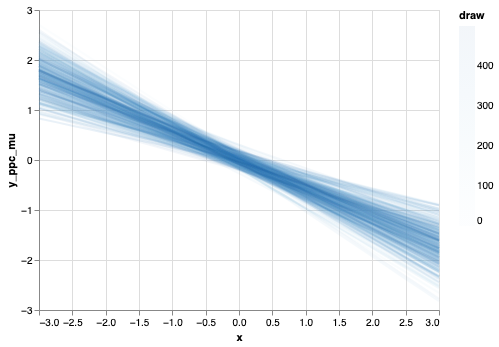

In [903]:
temp = lines_df[lines_df.chain==0]

alt.Chart(temp).mark_line(opacity=0.05).encode(
    x='x',
    y=alt.Y('y_ppc_mu'),
    color='draw'
)

We can reproduce the second plot shown in Fig. 5.2 of Stat. Rethinking, which shows the regression line for divorce rate on age at marriage. He shows the uncertainty captured by our posterior distribution on the parameters a and b as a gray shaded region. Note that this is not the full uncertainty we expect for divorce rate incorporating the parameter sigma in our model. We show that in the next figure below (he doesn't plot this in the text).

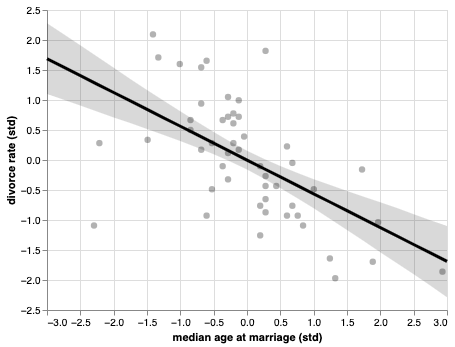

In [907]:
temp = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
temp['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(data_df).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('A', title='median age at marriage (std)'),
    alt.Y('D', title='divorce rate (std)')
)

line = alt.Chart(temp).mark_line(size=3, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu'),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_ppc_mu_lower:Q',
    y2='y_ppc_mu_upper:Q'
)

points+area+line

This plot shows the divorce rate predicted by our model, including the uncertainty captured by the parameter sigma. 

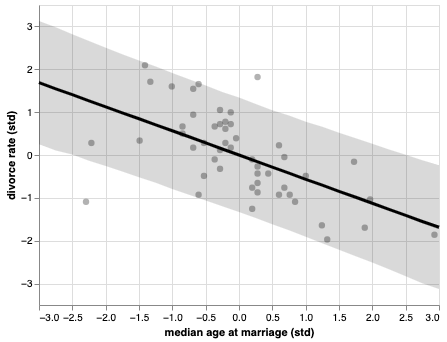

In [908]:
temp = samp_post_pred_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_lower'] = samp_post_pred_df.groupby('y_ppc_dim_1').y_ppc.quantile(0.055).values
temp['y_upper'] = samp_post_pred_df.groupby('y_ppc_dim_1').y_ppc.quantile(0.945).values

points = alt.Chart(data_df).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('A', title='median age at marriage (std)'),
    alt.Y('D', title='divorce rate (std)')
)

line = alt.Chart(temp).mark_line(size=3, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc'),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_lower:Q',
    y2='y_upper:Q'
)

points+area+line

#### Model m5_2 (marriage rate as single predictor)

In [909]:
x = np.transpose([data_df.M.values]).tolist()
x_ppc = np.transpose([np.arange(-3, 3.25, 0.25)]).tolist()
y = list(data_df.D.values)

data_m5_2 = {
    'N_obs': len(data_df),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 30,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [910]:
fit_m5_2 = stan_model.sample(data=data_m5_2, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 4
INFO:cmdstanpy:finish chain 3


In [911]:
azdata_m5_2 = az.from_cmdstanpy(
    posterior = fit_m5_2, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [912]:
sum5_2 = az.summary(azdata_m5_2)
sum5_2

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,0.002,0.119,-0.236,0.224,0.003,0.003,2002.0,941.0,2015.0,1415.0,1.0
b[0],0.356,0.132,0.104,0.606,0.003,0.002,1657.0,1575.0,1662.0,1462.0,1.0
sigma,0.949,0.094,0.777,1.121,0.002,0.002,1766.0,1739.0,1750.0,1470.0,1.0


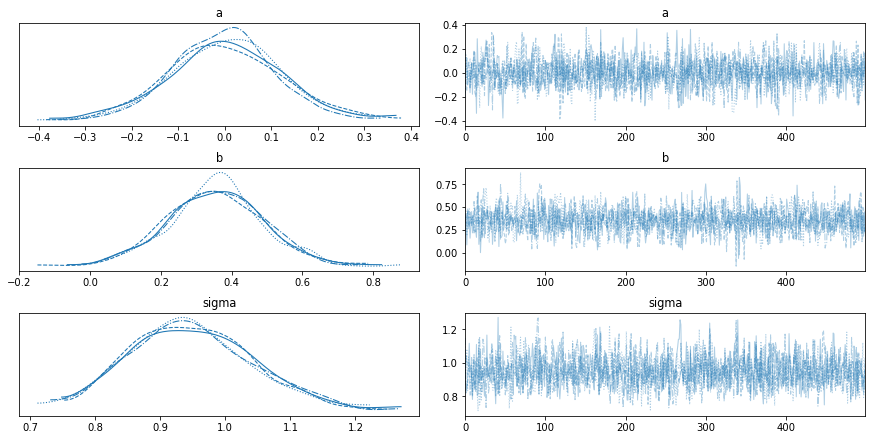

In [913]:
az.plot_trace(azdata_m5_2)

plt.show()

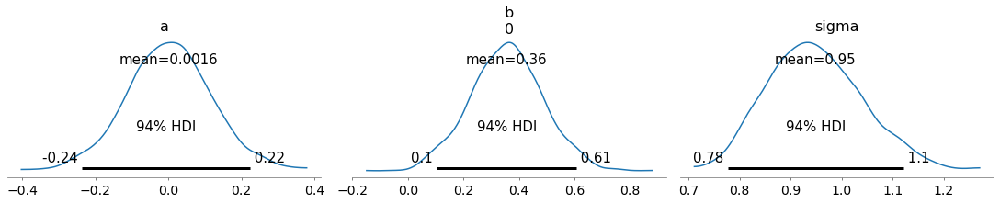

In [914]:
az.plot_posterior(azdata_m5_2, figsize=[15, 3])

plt.show()

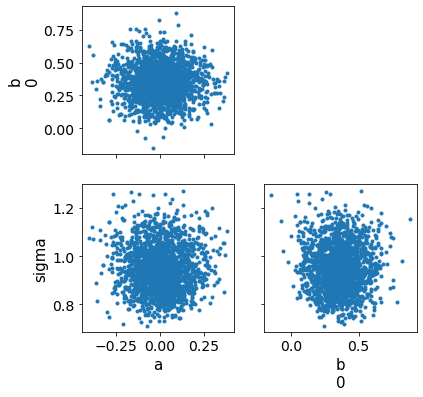

In [915]:
az.plot_pair(azdata_m5_2, var_names=['a', 'b', 'sigma'], kind='scatter', figsize=(6, 6))

plt.show()

In [916]:
samp_post_df = azdata_m5_2.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_2.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':[x[0] for x in x_ppc]}) # flatten out x_ppc
temp['y_ppc_dim_1'] = temp.index.values
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [917]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

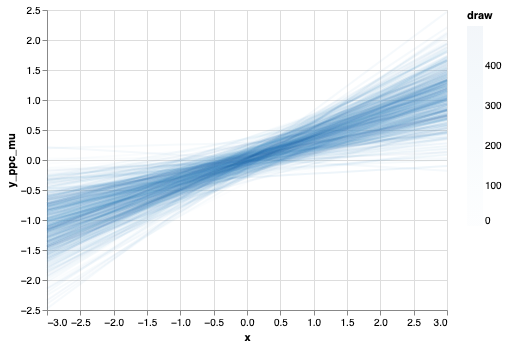

In [918]:
temp = lines_df[lines_df.chain==0]

alt.Chart(temp).mark_line(opacity=0.05).encode(
    x='x',
    y=alt.Y('y_ppc_mu'),
    color='draw'
)

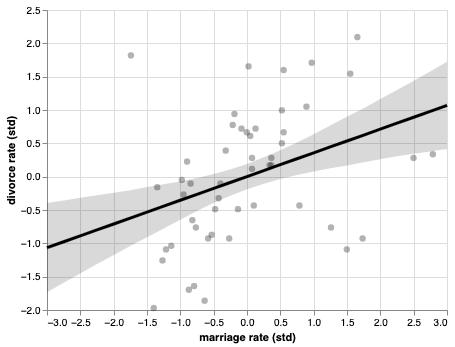

In [919]:
temp = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
temp['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(data_df).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('M', title='marriage rate (std)'),
    alt.Y('D', title='divorce rate (std)')
)

line = alt.Chart(temp).mark_line(size=3, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu'),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_ppc_mu_lower:Q',
    y2='y_ppc_mu_upper:Q'
)

points+area+line

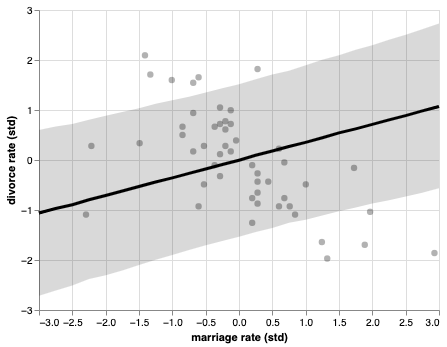

In [920]:
temp = samp_post_pred_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_lower'] = samp_post_pred_df.groupby('y_ppc_dim_1').y_ppc.quantile(0.055).values
temp['y_upper'] = samp_post_pred_df.groupby('y_ppc_dim_1').y_ppc.quantile(0.945).values

points = alt.Chart(data_df).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('A', title='marriage rate (std)'),
    alt.Y('D', title='divorce rate (std)')
)

line = alt.Chart(temp).mark_line(size=3, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc'),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_lower:Q',
    y2='y_upper:Q'
)

points+area+line

#### Model m5_3 (including both predictors)

In [881]:
x = np.transpose([data_df.A.values, data_df.M.values]).tolist()
x_ppc = x # for the ppc, we're going to consider the predictions on the original data points
y = list(data_df.D.values)

data_m5_3 = {
    'N_obs': len(data_df),
    'K': 2,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 30,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [882]:
fit_m5_3 = stan_model.sample(data=data_m5_3, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 3
INFO:cmdstanpy:finish chain 4


In [883]:
azdata_m5_3 = az.from_cmdstanpy(
    posterior = fit_m5_3, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x':x, 'y':y}
)

In [884]:
sum5_3 = az.summary(azdata_m5_3)
sum5_3

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.001,0.100,-0.190,0.178,0.002,0.002,1872.0,1003.0,1873.0,1344.0,1.0
b[0],-0.614,0.161,-0.925,-0.310,0.004,0.003,1547.0,1547.0,1557.0,1206.0,1.0
b[1],-0.065,0.160,-0.373,0.238,0.004,0.003,1556.0,1130.0,1551.0,1365.0,1.0
sigma,0.826,0.084,0.678,0.973,0.002,0.001,1831.0,1805.0,1844.0,1380.0,1.0


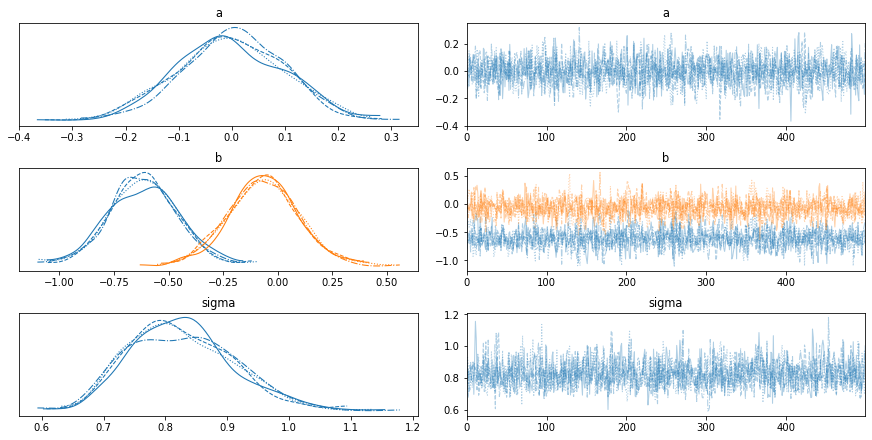

In [885]:
az.plot_trace(azdata_m5_3)

plt.show()

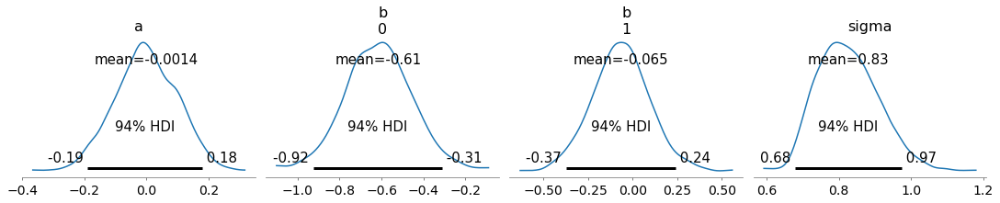

In [886]:
az.plot_posterior(azdata_m5_3, figsize=[15, 3])

plt.show()

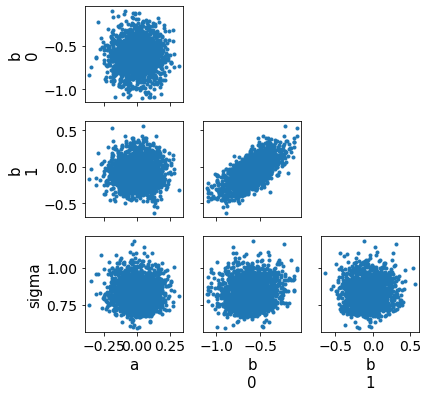

In [887]:
az.plot_pair(azdata_m5_3, var_names=['a', 'b', 'sigma'], kind='scatter', figsize=(6, 6))

plt.show()

In [888]:
bcompare_df = pd.DataFrame({
    'model':['bA_m5.1', 'bA_m5.2', 'bA_m5.3', 'bB_m5.1', 'bB_m5.2', 'bB_m5.3'],
    'value':[sum5_1.loc['b[0]']['mean'], np.nan, sum5_3.loc['b[0]']['mean'], np.nan, sum5_2.loc['b[0]']['mean'], sum5_3.loc['b[1]']['mean']],
    'low':[sum5_1.loc['b[0]']['hdi_3%'], np.nan, sum5_3.loc['b[0]']['hdi_3%'], np.nan, sum5_2.loc['b[0]']['hdi_3%'], sum5_3.loc['b[1]']['hdi_3%']],
    'high':[sum5_1.loc['b[0]']['hdi_97%'], np.nan, sum5_3.loc['b[0]']['hdi_97%'], np.nan, sum5_2.loc['b[0]']['hdi_97%'], sum5_3.loc['b[1]']['hdi_97%']]
})
bcompare_df['zero'] = 0

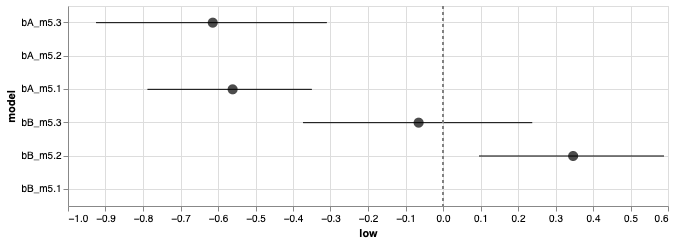

In [889]:
c1 = alt.Chart(bcompare_df).mark_circle(color='black', size=100).encode(
    x=alt.X('value:Q', scale=alt.Scale(domain=[-1, .5])),
    y=alt.Y('model:N',
            axis=alt.Axis(grid=True),
            scale=alt.Scale(domain=['bA_m5.3', 'bA_m5.2', 'bA_m5.1', 'bB_m5.3', 'bB_m5.2', 'bB_m5.1']))
).properties(
    width=600,
    height=200
)

c2 = alt.Chart(bcompare_df).mark_errorbar().encode(
    x="low:Q",
    x2="high:Q",
    y="model:N",
)

c3 = alt.Chart().mark_rule(color='gray',strokeDash=[3,3]).encode(x='zero')

c1+c2+c3

In the above plot (see page 133), we see that when including both age at marriage and marriage rate, the impact of marriage rate on predicting divorce rate is diminished, while the impact of age at marriage remains roughly the same. This implies that age at marriage might be a common cause for both divorce rate and marriage rate, and marriage rate adds very little additional influence on divorce rate.

In [890]:
# the unstack pivots coefs to columns; a and sigma columns are scalar
samp_post_df = azdata_m5_3.posterior.to_dataframe().unstack(level=0).reset_index().rename_axis((None,None), axis=1)
samp_post_df.columns = ['_'.join([str(c) for c in col]).strip('_') for col in samp_post_df.columns]
samp_post_df.drop(['a_1','sigma_1'], inplace=True, axis=1)
samp_post_df.rename(columns={'a_0':'a', 'sigma_0':'sigma'}, inplace=True)

samp_post_pred_df = azdata_m5_3.posterior_predictive.to_dataframe().reset_index()
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

temp = data_df[['A', 'M', 'D']].copy().rename(columns={'A':'x_0', 'M':'x_1', 'D':'y'})
temp['y_ppc_dim_1'] = temp.index.values
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')

samp_post_pred_df['mu'] = samp_post_pred_df.pipe(lambda x: x.a + x.b_0*x.x_0 + x.b_1*x.x_1)

preds_df = samp_post_pred_df.groupby(['y_ppc_dim_1']).mean().reset_index().rename({'y_ppc': 'y_pred_mean'}, axis=1)
preds_df['y_pred_low'] = samp_post_pred_df.groupby(['y_ppc_dim_1']).y_ppc.quantile(0.055).values
preds_df['y_pred_high'] = samp_post_pred_df.groupby(['y_ppc_dim_1']).y_ppc.quantile(0.945).values
preds_df['mu_low'] = samp_post_pred_df.groupby(['y_ppc_dim_1']).mu.quantile(0.055).values
preds_df['mu_high'] = samp_post_pred_df.groupby(['y_ppc_dim_1']).mu.quantile(0.945).values
preds_df['y_obs'] = data_df['D'].values

In [891]:
# length y_ppc_dim_0 = 30, num y samples
# length y_ppc_dim_1 = 50, num x_ppc points (50 states)
samp_post_pred_df.head()

,chain,draw,y_ppc_dim_0,y_ppc_dim_1,y_ppc,a,b_0,b_1,sigma,x_0,x_1,y,mu
0,0,0,0,0,-0.142396,-0.030911,-0.532524,-0.017462,0.918039,-0.606290,0.022644,1.654205,0.291557
1,0,0,0,1,0.252333,-0.030911,-0.532524,-0.017462,0.918039,-0.686699,1.549802,1.544364,0.307710
2,0,0,0,2,-0.823343,-0.030911,-0.532524,-0.017462,0.918039,-0.204241,0.048974,0.610716,0.076997
3,0,0,0,3,-0.745445,-0.030911,-0.532524,-0.017462,0.918039,-1.410387,1.655123,2.093569,0.691252
4,0,0,0,4,-0.800221,-0.030911,-0.532524,-0.017462,0.918039,0.599857,-0.266989,-0.927058,-0.345687


In [892]:
preds_df.head()

,y_ppc_dim_1,chain,draw,y_ppc_dim_0,y_pred_mean,a,b_0,b_1,sigma,x_0,x_1,y,mu,y_pred_low,y_pred_high,mu_low,mu_high,y_obs
0,0,1.5,249.5,14.5,0.370981,-0.001445,-0.613614,-0.064873,0.826378,-0.606290,0.022644,1.654205,0.369113,-0.975100,1.711387,0.159869,0.587004,1.654205
1,1,1.5,249.5,14.5,0.322809,-0.001445,-0.613614,-0.064873,0.826378,-0.686699,1.549802,1.544364,0.319383,-1.044702,1.687803,-0.032847,0.664853,1.544364
2,2,1.5,249.5,14.5,0.115998,-0.001445,-0.613614,-0.064873,0.826378,-0.204241,0.048974,0.610716,0.120703,-1.221377,1.443961,-0.042323,0.280678,0.610716
3,3,1.5,249.5,14.5,0.757506,-0.001445,-0.613614,-0.064873,0.826378,-1.410387,1.655123,2.093569,0.756616,-0.624311,2.139626,0.389322,1.116104,2.093569
4,4,1.5,249.5,14.5,-0.356410,-0.001445,-0.613614,-0.064873,0.826378,0.599857,-0.266989,-0.927058,-0.352206,-1.697613,0.986404,-0.557646,-0.156881,-0.927058


#### Posterior predictive plots

Here we reproduce Fig. 5.5, which shows the predicted divorce rate vs observed, including the compatibility interval as error bars. The predicted divorce rate is the posterior predictive value, not taking into account the effect of sigma. In the second plot below we show the full model predicted values including sigma.

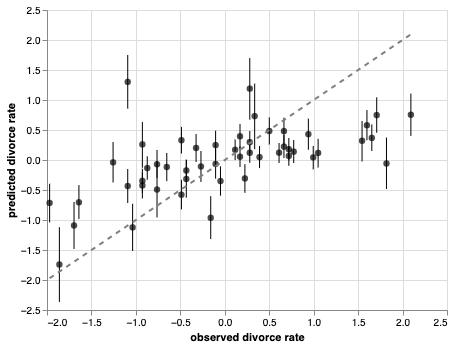

In [803]:
points = alt.Chart(preds_df).mark_circle(size=40, color='black').encode(
    alt.X('y_obs', title='observed divorce rate', scale=alt.Scale(domain=[-2, 2.25])),
    alt.Y('mu', title='predicted divorce rate')
)

eb = alt.Chart(preds_df).mark_errorbar().encode(
    x="y_obs:Q",
    y=alt.Y("mu_low:Q", title=''),
    y2="mu_high:Q",
)

line = alt.Chart(preds_df).mark_line(color='gray', strokeDash=[5, 5]).encode(
    alt.X('y_obs'),
    alt.Y('y_obs')
)

points + eb + line

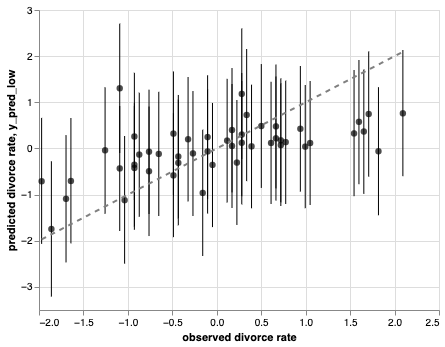

In [804]:
points = alt.Chart(preds_df).mark_circle(size=40, color='black').encode(
    alt.X('y_obs', title='observed divorce rate', scale=alt.Scale(domain=[-2, 2.25])),
    alt.Y('y_pred_mean', title='predicted divorce rate')
)

eb = alt.Chart(preds_df).mark_errorbar().encode(
    x="y_obs:Q",
    y="y_pred_low:Q",
    y2="y_pred_high:Q",
)

line = alt.Chart(preds_df).mark_line(color='gray', strokeDash=[5, 5]).encode(
    alt.X('y_obs'),
    alt.Y('y_obs')
)

points + eb + line

### Investigating variable association and possible causal explanations

#### Predictor residual plots for marriage rate

In [976]:
x = np.transpose([data_df.A.values]).tolist()
x_ppc = x
# NOTE: now for the target variable, we are taking marriage rate
y = list(data_df.M.values)

data_m5_4 = {
    'N_obs': len(data_df),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 30,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [977]:
fit_m5_4 = stan_model.sample(data=data_m5_4, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 4
INFO:cmdstanpy:finish chain 3


In [978]:
azdata_m5_4 = az.from_cmdstanpy(
    posterior = fit_m5_4, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [979]:
sum5_4 = az.summary(azdata_m5_4)
sum5_4

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.001,0.089,-0.173,0.166,0.002,0.002,1998.0,1080.0,2004.0,1437.0,1.0
b[0],-0.695,0.098,-0.870,-0.503,0.002,0.002,1945.0,1843.0,1947.0,1112.0,1.0
sigma,0.710,0.074,0.572,0.852,0.002,0.001,2043.0,2030.0,2039.0,1519.0,1.0


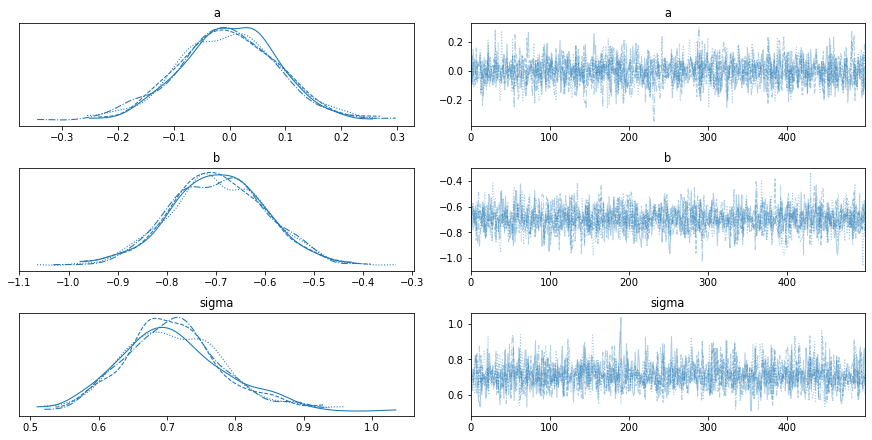

In [980]:
az.plot_trace(azdata_m5_4)

plt.show()

In [981]:
samp_post_df = azdata_m5_4.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_4.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':data_df.A.values, 'y_obs':data_df.M.values, 'y_ppc_dim_1':data_df.index.values, 'D':data_df.D.values})
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [982]:
samp_post_pred_df.head()

,chain,draw,y_ppc_dim_0,y_ppc_dim_1,y_ppc,x,y_obs,D,b_dim_0,a,b,sigma
0,0,0,0,0,1.239650,-0.606290,0.022644,1.654205,0,0.033621,-0.788552,0.8367
1,0,0,0,1,-0.030460,-0.686699,1.549802,1.544364,0,0.033621,-0.788552,0.8367
2,0,0,0,2,-0.003298,-0.204241,0.048974,0.610716,0,0.033621,-0.788552,0.8367
3,0,0,0,3,1.948110,-1.410387,1.655123,2.093569,0,0.033621,-0.788552,0.8367
4,0,0,0,4,-0.667270,0.599857,-0.266989,-0.927058,0,0.033621,-0.788552,0.8367


In [983]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

We can reproduce the second plot shown in Fig. 5.2 of Stat. Rethinking, which shows the regression line for divorce rate on age at marriage. He shows the uncertainty captured by our posterior distribution on the parameters a and b as a gray shaded region. Note that this is not the full uncertainty we expect for divorce rate incorporating the parameter sigma in our model. We show that in the next figure below (he doesn't plot this in the text).

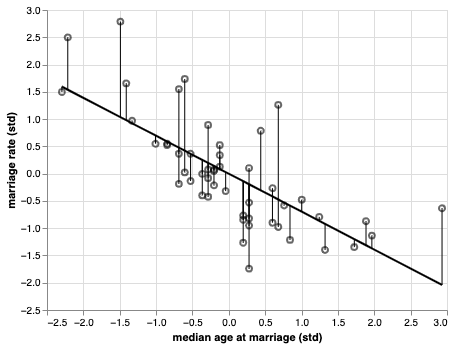

In [985]:
res_df = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
res_df['residual'] = res_df.apply(lambda x: x.y_obs - x.y_ppc_mu, axis=1)
res_df['residual_min'] = res_df.apply(lambda x: min(x.y_obs, x.y_ppc_mu), axis=1)
res_df['residual_max'] = res_df.apply(lambda x: max(x.y_obs, x.y_ppc_mu), axis=1)
res_df['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
res_df['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(data_df).mark_point(size=35, opacity=0.6, color='black').encode(
    alt.X('A', title='median age at marriage (std)'),
    alt.Y('M', title='marriage rate (std)')
)

res_eb = alt.Chart(res_df).mark_errorbar().encode(
    x="x:Q",
    y=alt.Y("residual_min:Q", title=''),
    y2="residual_max:Q",
)

line = alt.Chart(res_df).mark_line(size=2, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu', title=''),
)

points+res_eb+line

Ok, now we're going to do a regression of divorce rate on the residuals of marriage rate. This will show if there is any additional relationship between divorce rate and marriage rate, having already conditioned on median age at marriage.

In [986]:
x = np.transpose([res_df.residual.values]).tolist()
x_ppc = x
y = list(res_df.D.values)

data_m5_4b = {
    'N_obs': len(y),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 30,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [987]:
fit_m5_4b = stan_model.sample(data=data_m5_4b, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 3
INFO:cmdstanpy:finish chain 4


In [988]:
azdata_m5_4b = az.from_cmdstanpy(
    posterior = fit_m5_4b, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [989]:
sum5_4b = az.summary(azdata_m5_4b)
sum5_4b

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,0.005,0.117,-0.217,0.217,0.003,0.003,1833.0,1033.0,1835.0,1478.0,1.0
b[0],-0.075,0.191,-0.431,0.282,0.005,0.004,1688.0,1132.0,1706.0,1372.0,1.0
sigma,1.020,0.108,0.820,1.223,0.003,0.002,1301.0,1256.0,1353.0,1330.0,1.0


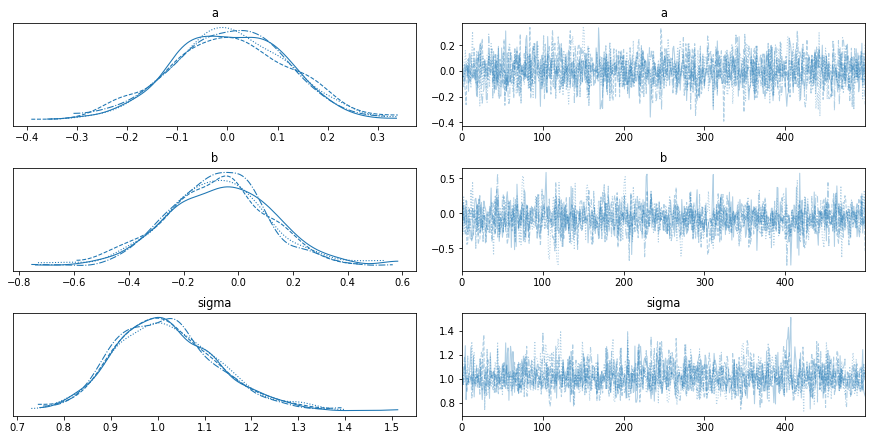

In [990]:
az.plot_trace(azdata_m5_4b)

plt.show()

In [1001]:
samp_post_df = azdata_m5_4b.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_4b.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':res_df.residual.values, 'y_obs':res_df.D.values, 'y_ppc_dim_1':res_df.index.values})
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [1002]:
samp_post_pred_df.head()

,chain,draw,y_ppc_dim_0,y_ppc_dim_1,y_ppc,x,y_obs,b_dim_0,a,b,sigma
0,0,0,0,0,-1.046060,-0.397478,1.654205,0,-0.071804,0.124364,1.02734
1,0,0,0,1,1.121150,1.073781,1.544364,0,-0.071804,0.124364,1.02734
2,0,0,0,2,0.725459,-0.091658,0.610716,0,-0.071804,0.124364,1.02734
3,0,0,0,3,0.104736,0.676021,2.093569,0,-0.071804,0.124364,1.02734
4,0,0,0,4,-0.464805,0.151358,-0.927058,0,-0.071804,0.124364,1.02734


In [1003]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

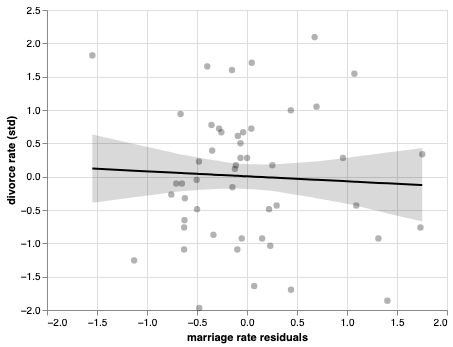

In [1006]:
temp = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
temp['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(temp).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('x', title='marriage rate residuals'),
    alt.Y('y_obs', title='divorce rate (std)')
)

line = alt.Chart(temp).mark_line(size=2, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu', title=''),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_ppc_mu_lower:Q',
    y2='y_ppc_mu_upper:Q'
)

points+area+line

#### Predictor residual plots for median age at marriage

In [1007]:
x = np.transpose([data_df.M.values]).tolist()
x_ppc = x
y = list(data_df.A.values)

data_m5_5 = {
    'N_obs': len(data_df),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 30,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [1008]:
fit_m5_5 = stan_model.sample(data=data_m5_5, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 4
INFO:cmdstanpy:finish chain 3


In [1009]:
azdata_m5_5 = az.from_cmdstanpy(
    posterior = fit_m5_5, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [1010]:
sum5_5 = az.summary(azdata_m5_5)
sum5_5

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,0.001,0.089,-0.155,0.170,0.002,0.002,1813.0,1176.0,1826.0,1278.0,1.0
b[0],-0.695,0.103,-0.886,-0.509,0.002,0.002,1960.0,1927.0,1968.0,1381.0,1.0
sigma,0.710,0.070,0.581,0.840,0.002,0.001,1695.0,1662.0,1740.0,1344.0,1.0


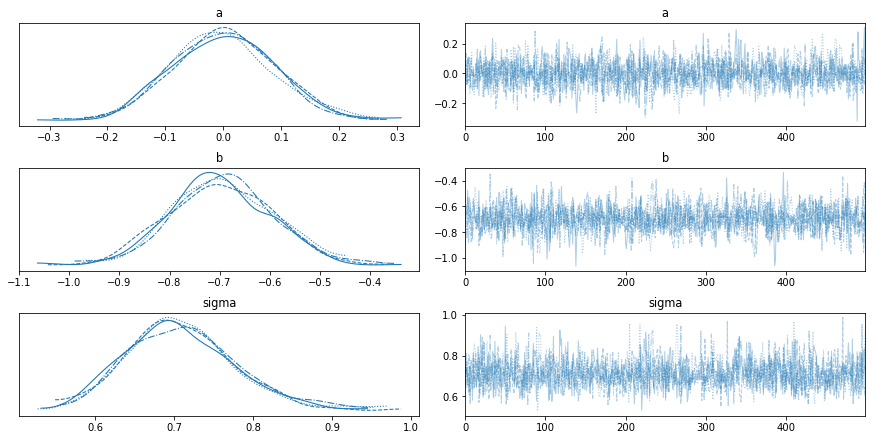

In [1011]:
az.plot_trace(azdata_m5_5)

plt.show()

In [1012]:
samp_post_df = azdata_m5_5.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_5.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':data_df.M.values, 'y_obs':data_df.A.values, 'y_ppc_dim_1':data_df.index.values, 'D':data_df.D.values})
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [1013]:
samp_post_pred_df.head()

,chain,draw,y_ppc_dim_0,y_ppc_dim_1,y_ppc,x,y_obs,D,b_dim_0,a,b,sigma
0,0,0,0,0,0.047103,0.022644,-0.606290,1.654205,0,0.037659,-0.758777,0.649603
1,0,0,0,1,-0.472330,1.549802,-0.686699,1.544364,0,0.037659,-0.758777,0.649603
2,0,0,0,2,-0.880132,0.048974,-0.204241,0.610716,0,0.037659,-0.758777,0.649603
3,0,0,0,3,-0.624438,1.655123,-1.410387,2.093569,0,0.037659,-0.758777,0.649603
4,0,0,0,4,-0.712818,-0.266989,0.599857,-0.927058,0,0.037659,-0.758777,0.649603


In [1014]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

We can reproduce the second plot shown in Fig. 5.2 of Stat. Rethinking, which shows the regression line for divorce rate on age at marriage. He shows the uncertainty captured by our posterior distribution on the parameters a and b as a gray shaded region. Note that this is not the full uncertainty we expect for divorce rate incorporating the parameter sigma in our model. We show that in the next figure below (he doesn't plot this in the text).

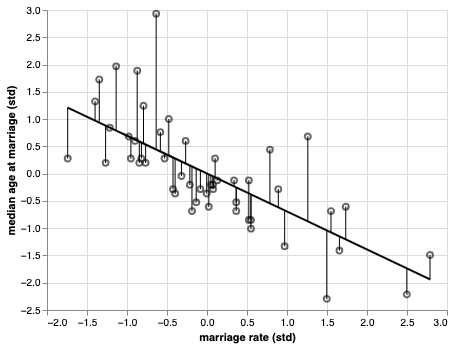

In [1015]:
res_df = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
res_df['residual'] = res_df.apply(lambda x: x.y_obs - x.y_ppc_mu, axis=1)
res_df['residual_min'] = res_df.apply(lambda x: min(x.y_obs, x.y_ppc_mu), axis=1)
res_df['residual_max'] = res_df.apply(lambda x: max(x.y_obs, x.y_ppc_mu), axis=1)
res_df['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
res_df['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(data_df).mark_point(size=35, opacity=0.6, color='black').encode(
    alt.X('M', title='marriage rate (std)'),
    alt.Y('A', title='median age at marriage (std)')
)

res_eb = alt.Chart(res_df).mark_errorbar().encode(
    x="x:Q",
    y=alt.Y("residual_min:Q", title=''),
    y2="residual_max:Q",
)

line = alt.Chart(res_df).mark_line(size=2, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu', title=''),
)

points+res_eb+line

Similarly as we did for marriage rate, now we're going to do a regression of divorce rate on the residuals of median age at marriage. This will show if there is any additional relationship between divorce rate and median age at marriage, having already conditioned on marriage rate.

In [1016]:
x = np.transpose([res_df.residual.values]).tolist()
x_ppc = x
y = list(res_df.D.values)

data_m5_5b = {
    'N_obs': len(y),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 30,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [1017]:
fit_m5_5b = stan_model.sample(data=data_m5_5b, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 3
INFO:cmdstanpy:finish chain 4


In [1018]:
azdata_m5_5b = az.from_cmdstanpy(
    posterior = fit_m5_5b, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [1019]:
sum5_5b = az.summary(azdata_m5_5b)
sum5_5b

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,0.003,0.111,-0.213,0.205,0.002,0.002,2042.0,1117.0,2044.0,1357.0,1.0
b[0],-0.617,0.174,-0.948,-0.292,0.004,0.003,1605.0,1605.0,1611.0,1439.0,1.0
sigma,0.892,0.089,0.741,1.067,0.002,0.002,1684.0,1612.0,1786.0,1366.0,1.0


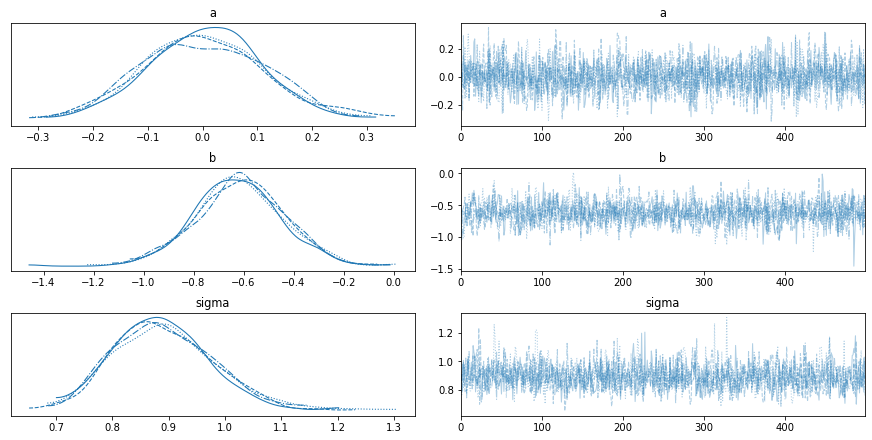

In [1020]:
az.plot_trace(azdata_m5_5b)

plt.show()

In [1021]:
samp_post_df = azdata_m5_5b.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_5b.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':res_df.residual.values, 'y_obs':res_df.D.values, 'y_ppc_dim_1':res_df.index.values})
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [1022]:
samp_post_pred_df.head()

,chain,draw,y_ppc_dim_0,y_ppc_dim_1,y_ppc,x,y_obs,b_dim_0,a,b,sigma
0,0,0,0,0,0.622711,-0.591127,1.654205,0,-0.051767,-0.731935,0.866583
1,0,0,0,1,-0.150955,0.390180,1.544364,0,-0.051767,-0.731935,0.866583
2,0,0,0,2,-0.488064,-0.170773,0.610716,0,-0.051767,-0.731935,0.866583
3,0,0,0,3,-0.109345,-0.260286,2.093569,0,-0.051767,-0.731935,0.866583
4,0,0,0,4,-1.004060,0.413659,-0.927058,0,-0.051767,-0.731935,0.866583


In [1023]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

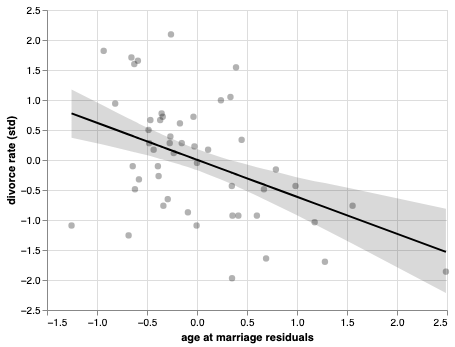

In [1024]:
temp = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
temp['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(temp).mark_circle(size=40, opacity=0.3, color='black').encode(
    alt.X('x', title='age at marriage residuals'),
    alt.Y('y_obs', title='divorce rate (std)')
)

line = alt.Chart(temp).mark_line(size=2, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu', title=''),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_ppc_mu_lower:Q',
    y2='y_ppc_mu_upper:Q'
)

points+area+line

#### Counterfactual plots for manipulating age at marriage

Now we have to update our model code. For this model, we are going to build into it the assumption that age at marriage has a direct influence on marriage rate (a linear relationship). 

In [1025]:
model_file = "./stan_artifacts/model_divorce_cf.stan"

In [1114]:
model_code = """
data {
  int<lower=1> N_obs;
  int<lower=1> NM_samp;
  int<lower=1> ND_samp;
  int<lower=1> NA_sim;
  vector[N_obs] A;
  vector[N_obs] M;
  vector[N_obs] D;
  vector[NA_sim] A_sim; 
}
parameters {
  real a;
  real aM;
  real bM;
  real bA;
  real bAM;
  real<lower=0> sigma;
  real<lower=0> sigma_M;
}
model {
  a ~ normal(0, 0.2);
  bM ~ normal(0, 0.5);
  bA ~ normal(0, 0.5);
  sigma ~ exponential(1);
  aM ~ normal(0, 0.2);
  bAM ~ normal(0, 0.5);
  sigma_M ~ exponential(1);
  M ~ normal(aM + bAM*A, sigma_M);
  D ~ normal(a + bM*M + bA*A, sigma);
}
generated quantities {
  real M_sim[NM_samp, NA_sim];
  real D_sim[ND_samp, NM_samp, NA_sim];
  for (i in 1:NM_samp) {
    M_sim[i] = normal_rng(aM + bAM*A_sim, sigma_M);
  }
  for (k in 1:ND_samp) {
    for (i in 1:NM_samp) {
      for (j in 1:NA_sim) {
        D_sim[k, i, j] = normal_rng(a + bA*A_sim[j] + bM*M_sim[i, j], sigma);
      }
    }  
  }
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [1115]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_cf
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_cf
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_cf


In [1129]:
A_sim = np.arange(-2, 2.5, 0.5).tolist()
A = list(data_df.A.values)
M = list(data_df.M.values)
D = list(data_df.D.values)

data_m5_3_A = {
    'N_obs': len(D),
    'NM_samp': 10,
    'ND_samp': 20,
    'NA_sim': len(A_sim),
    'A': A,
    'M': M,
    'D': D,
    'A_sim': A_sim
}

In [1130]:
fit_m5_3_A = stan_model.sample(data=data_m5_3_A, iter_sampling=100, iter_warmup=500, chains=2)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 1


In [1131]:
azdata_m5_3_A = az.from_cmdstanpy(
    posterior = fit_m5_3_A, 
    posterior_predictive = ['M_sim', 'D_sim'],
    observed_data = {'A':A, 'M':M, 'D':D}
)

In [1132]:
sum5_3_A = az.summary(azdata_m5_3_A)
sum5_3_A

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,0.003,0.099,-0.192,0.160,0.005,0.006,333.0,162.0,328.0,177.0,1.01
aM,-0.010,0.099,-0.175,0.199,0.007,0.007,212.0,91.0,200.0,82.0,0.99
bM,-0.064,0.159,-0.386,0.200,0.011,0.013,224.0,81.0,221.0,79.0,1.00
bA,-0.612,0.168,-0.873,-0.310,0.011,0.009,241.0,189.0,246.0,118.0,1.00
bAM,-0.688,0.099,-0.879,-0.510,0.008,0.006,172.0,155.0,182.0,79.0,1.01
sigma,0.817,0.072,0.700,0.953,0.005,0.004,209.0,205.0,196.0,139.0,1.00
sigma_M,0.708,0.076,0.579,0.856,0.004,0.003,322.0,310.0,325.0,156.0,0.99


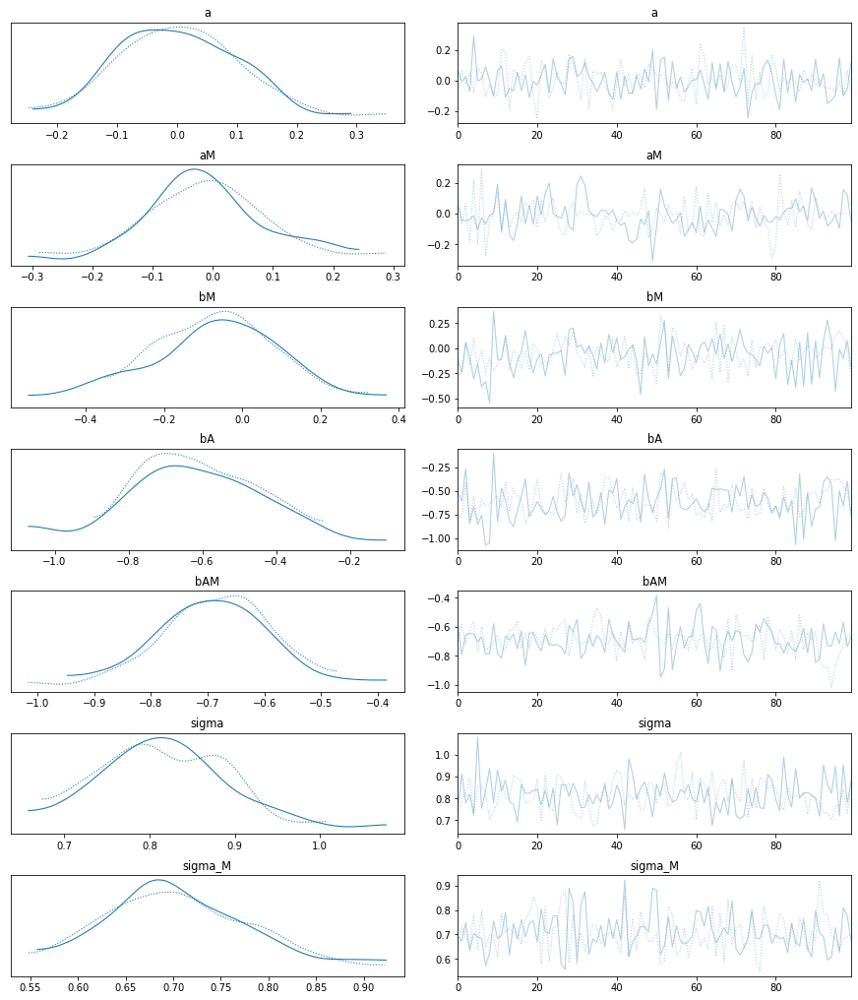

In [1133]:
az.plot_trace(azdata_m5_3_A)

plt.show()

In [1134]:
samp_post_df = azdata_m5_3_A.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_3_A.posterior_predictive.to_dataframe().reset_index()

In [1135]:
print(samp_post_df.shape)
samp_post_df.head()

(200, 9)


,chain,draw,a,aM,bM,bA,bAM,sigma,sigma_M
0,0,0,0.074563,0.066904,-0.113982,-0.511266,-0.590214,0.739591,0.693652
1,0,1,-0.007079,-0.044032,-0.240653,-0.604801,-0.790188,0.912292,0.673730
2,0,2,0.025746,-0.047532,0.057916,-0.260369,-0.654656,0.778558,0.747905
3,0,3,-0.070927,-0.035981,-0.085660,-0.845772,-0.644917,0.819697,0.633680
4,0,4,0.290903,-0.012478,-0.307597,-0.663663,-0.647891,0.721452,0.704110


In [1136]:
print(samp_post_pred_df.shape)
samp_post_pred_df.head()

(32400000, 9)


,D_sim_dim_0,D_sim_dim_1,D_sim_dim_2,M_sim_dim_0,M_sim_dim_1,chain,draw,M_sim,D_sim
0,0,0,0,0,0,0,0,0.742843,0.984046
1,0,0,0,0,0,0,1,1.252970,1.212590
2,0,0,0,0,0,0,2,1.952990,1.097920
3,0,0,0,0,0,0,3,0.857785,0.536344
4,0,0,0,0,0,0,4,0.490546,1.276460


In [1125]:
len(A_sim)

9

In [1137]:
samp_post_pred_df.max()

D_sim_dim_0    19.00000
D_sim_dim_1     9.00000
D_sim_dim_2     8.00000
M_sim_dim_0     9.00000
M_sim_dim_1     8.00000
chain           1.00000
draw           99.00000
M_sim           4.29820
D_sim           4.88333
dtype: float64

In [1157]:
# first eliminate extra entries due to M_sim
lines_df = samp_post_pred_df.groupby(['D_sim_dim_0', 'D_sim_dim_1', 'D_sim_dim_2', 'chain', 'draw']).first().reset_index()

In [1158]:
temp = lines_df.groupby('D_sim_dim_2').mean().reset_index()
temp['D_lower'] = lines_df.groupby('D_sim_dim_2').D_sim.quantile(0.055).values
temp['D_upper'] = lines_df.groupby('D_sim_dim_2').D_sim.quantile(0.945).values
temp['A_sim'] = A_sim

In [1159]:
temp.head()

,D_sim_dim_2,D_sim_dim_0,D_sim_dim_1,chain,draw,M_sim_dim_0,M_sim_dim_1,M_sim,D_sim,D_lower,D_upper,A_sim
0,0,9.5,4.5,0.5,49.5,0.0,0.0,1.348551,1.145808,-0.230346,2.521395,-2.0
1,1,9.5,4.5,0.5,49.5,0.0,0.0,1.348551,0.854073,-0.503924,2.214891,-1.5
2,2,9.5,4.5,0.5,49.5,0.0,0.0,1.348551,0.581620,-0.761699,1.923452,-1.0
3,3,9.5,4.5,0.5,49.5,0.0,0.0,1.348551,0.292587,-1.051482,1.634802,-0.5
4,4,9.5,4.5,0.5,49.5,0.0,0.0,1.348551,-0.004403,-1.346387,1.336134,0.0


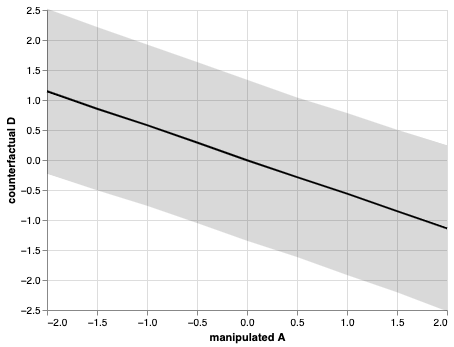

In [1165]:
line = alt.Chart(temp).mark_line(size=2, color='black').encode(
    x=alt.X('A_sim', title='manipulated A'),
    y=alt.Y('D_sim', title='counterfactual D', scale=alt.Scale(domain=[-2.5, 2.5]),),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='A_sim:Q',
    y='D_lower:Q',
    y2='D_upper:Q'
)

area+line

#### Counterfactual plots for manipulating marriage rate

Here, we keep the same causal model, but manipulate M, and set A=0 in the post predictive simulation.

In [1181]:
model_file = "./stan_artifacts/model_divorce_cf.stan"

In [1198]:
model_code = """
data {
  int<lower=1> N_obs;
  int<lower=1> ND_samp;
  int<lower=1> NM_sim;
  vector[N_obs] A;
  vector[N_obs] M;
  vector[N_obs] D;
  vector[NM_sim] M_sim; 
}
parameters {
  real a;
  real aA;
  real bA;
  real bM;
  real bMA;
  real<lower=0> sigma;
  real<lower=0> sigma_A;
}
model {
  a ~ normal(0, 0.2);
  bA ~ normal(0, 0.5);
  bM ~ normal(0, 0.5);
  sigma ~ exponential(1);
  aA ~ normal(0, 0.2);
  bMA ~ normal(0, 0.5);
  sigma_A ~ exponential(1);
  A ~ normal(aA + bMA*M, sigma_A);
  D ~ normal(a + bM*M + bA*A, sigma);
}
generated quantities {
  real A_sim = 0.0;
  real D_sim[ND_samp, NM_sim];
  for (k in 1:ND_samp) {
    for (j in 1:NM_sim) {
      D_sim[k, j] = normal_rng(a + bA*A_sim + bM*M_sim[j], sigma);
    }
  }
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [1199]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_cf
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_cf
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_divorce_cf


In [1200]:
M_sim = np.arange(-2, 2.5, 0.5).tolist()
A = list(data_df.A.values)
M = list(data_df.M.values)
D = list(data_df.D.values)

data_m5_3_M = {
    'N_obs': len(D),
    'ND_samp': 20,
    'NM_sim': len(M_sim),
    'A': A,
    'M': M,
    'D': D,
    'M_sim': M_sim
}

In [1201]:
fit_m5_3_M = stan_model.sample(data=data_m5_3_M, iter_sampling=100, iter_warmup=500, chains=2)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 1


In [1202]:
azdata_m5_3_M = az.from_cmdstanpy(
    posterior = fit_m5_3_M, 
    posterior_predictive = ['A_sim', 'D_sim'],
    observed_data = {'A':A, 'M':M, 'D':D}
)

In [1203]:
sum5_3_M = az.summary(azdata_m5_3_M)
sum5_3_M

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,0.002,0.089,-0.145,0.190,0.005,0.006,291.0,111.0,308.0,179.0,1.00
aA,0.005,0.095,-0.158,0.179,0.007,0.007,163.0,93.0,165.0,108.0,1.05
bA,-0.610,0.166,-0.873,-0.290,0.012,0.009,189.0,181.0,187.0,130.0,1.01
bM,-0.055,0.185,-0.365,0.283,0.013,0.011,196.0,147.0,201.0,184.0,1.01
bMA,-0.696,0.090,-0.859,-0.546,0.005,0.004,294.0,283.0,294.0,154.0,1.00
sigma,0.828,0.092,0.672,0.999,0.007,0.005,188.0,187.0,186.0,106.0,1.00
sigma_A,0.719,0.086,0.573,0.879,0.006,0.005,198.0,181.0,219.0,109.0,1.01


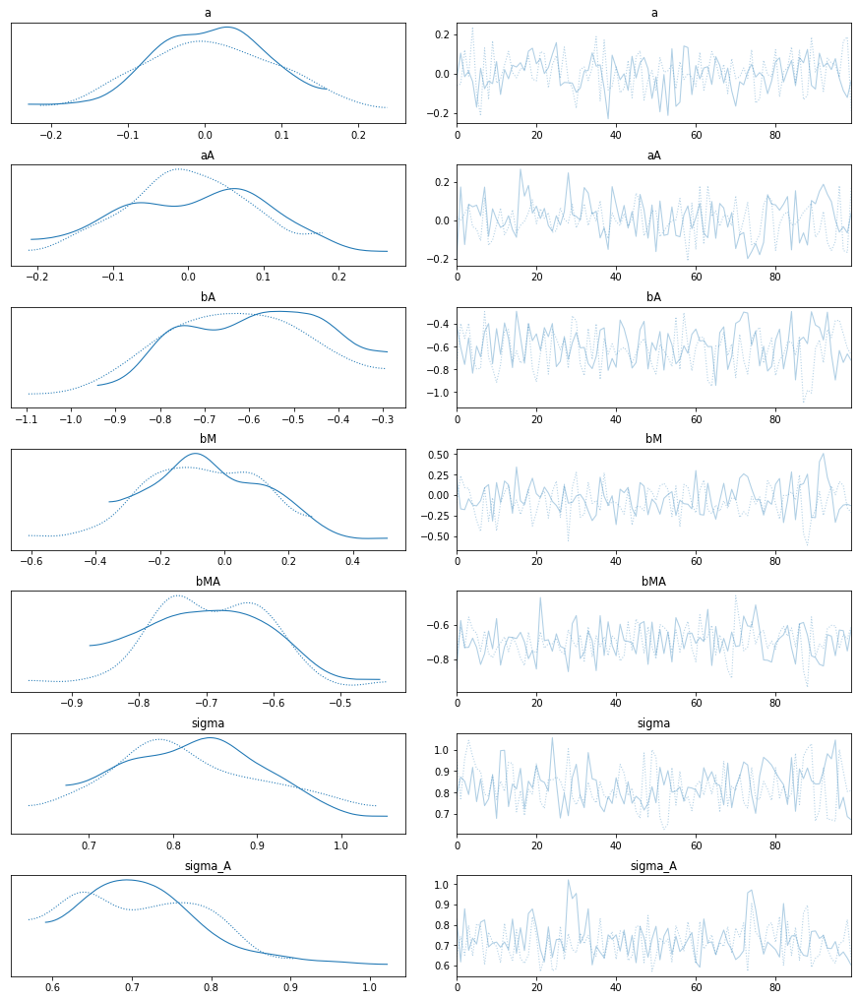

In [1204]:
az.plot_trace(azdata_m5_3_M)

plt.show()

In [1205]:
samp_post_df = azdata_m5_3_M.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_3_M.posterior_predictive.to_dataframe().reset_index()

In [1206]:
print(samp_post_df.shape)
samp_post_df.head()

(200, 9)


,chain,draw,a,aA,bA,bM,bMA,sigma,sigma_A
0,0,0,-0.027745,-0.208847,-0.405254,0.208724,-0.854969,0.785519,0.828840
1,0,1,0.104939,0.172374,-0.605710,-0.167323,-0.575177,0.872077,0.617049
2,0,2,-0.015422,-0.127420,-0.756425,-0.176585,-0.732971,0.852075,0.879491
3,0,3,0.012412,0.083157,-0.523570,-0.044454,-0.731805,0.790309,0.674466
4,0,4,-0.040111,0.069352,-0.833550,-0.120961,-0.678408,0.916981,0.734661


In [1207]:
print(samp_post_pred_df.shape)
samp_post_pred_df.head()

(36000, 6)


,D_sim_dim_0,D_sim_dim_1,chain,draw,A_sim,D_sim
0,0,0,0,0,0.0,0.120899
1,0,0,0,1,0.0,1.202170
2,0,0,0,2,0.0,-0.404977
3,0,0,0,3,0.0,-0.211621
4,0,0,0,4,0.0,-2.347770


In [1208]:
samp_post_pred_df.max()

D_sim_dim_0    19.00000
D_sim_dim_1     8.00000
chain           1.00000
draw           99.00000
A_sim           0.00000
D_sim           4.29478
dtype: float64

In [1209]:
# first eliminate extra entries due to A_sim
lines_df = samp_post_pred_df.groupby(['D_sim_dim_0', 'D_sim_dim_1', 'chain', 'draw']).first().reset_index()

temp = lines_df.groupby('D_sim_dim_1').mean().reset_index()
temp['D_lower'] = lines_df.groupby('D_sim_dim_1').D_sim.quantile(0.055).values
temp['D_upper'] = lines_df.groupby('D_sim_dim_1').D_sim.quantile(0.945).values
temp['M_sim'] = M_sim

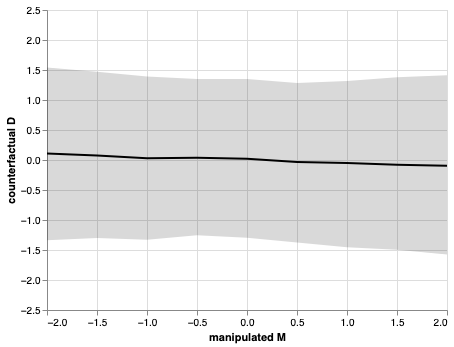

In [1210]:
line = alt.Chart(temp).mark_line(size=2, color='black').encode(
    x=alt.X('M_sim', title='manipulated M'),
    y=alt.Y('D_sim', title='counterfactual D', scale=alt.Scale(domain=[-2.5, 2.5]),),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='M_sim:Q',
    y='D_lower:Q',
    y2='D_upper:Q'
)

area+line

## Chapter 5.2: Masked Relationship

### Data

In [1368]:
data_df = pd.read_csv('https://raw.githubusercontent.com/rmcelreath/rethinking/master/data/milk.csv', sep=';')
data_df = data_df[['clade', 'species', 'kcal.per.g', 'neocortex.perc', 'mass']].copy()
# 'complete case analysis': drop rows with any missing values
data_df.dropna(inplace=True)
data_df.reset_index(inplace=True, drop=True)
# define standardized variables and take the log of mass
data_df['K'] = data_df['kcal.per.g'].pipe(lambda x: (x - x.mean()) / x.std())
data_df['N'] = data_df['neocortex.perc'].pipe(lambda x: (x - x.mean()) / x.std())
data_df['log_mass'] = np.log(data_df['mass'])
data_df['M'] = data_df['log_mass'].pipe(lambda x: (x - x.mean()) / x.std())
data_df.head()

,clade,species,kcal.per.g,neocortex.perc,mass,K,N,log_mass,M
0,Strepsirrhine,Eulemur fulvus,0.49,55.16,1.95,-0.969623,-2.080196,0.667829,-0.430154
1,New World Monkey,Alouatta seniculus,0.47,64.54,5.25,-1.085298,-0.508641,1.658228,0.082211
2,New World Monkey,A palliata,0.56,64.54,5.37,-0.564763,-0.508641,1.680828,0.093902
3,New World Monkey,Cebus apella,0.89,67.64,2.51,1.343864,0.010742,0.920283,-0.299552
4,New World Monkey,S sciureus,0.92,68.85,0.68,1.517376,0.213470,-0.385662,-0.975160


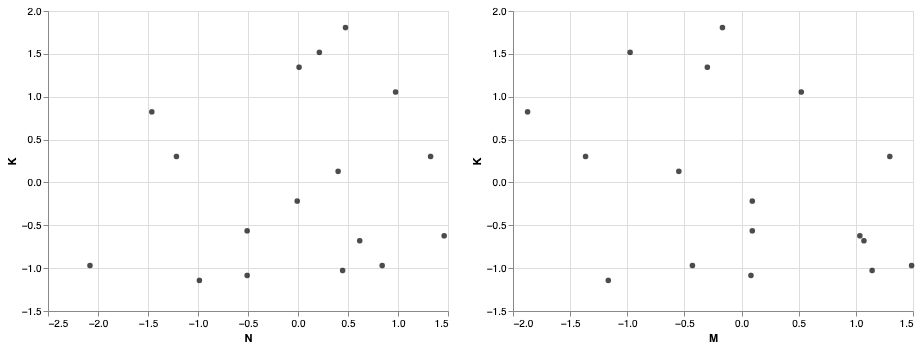

In [1226]:
base = alt.Chart(data_df)

mark_args = {'color':'black'}

c1 = base.mark_circle(**mark_args).encode(
    alt.X('N'),
    alt.Y('K')
)

c2 = base.mark_circle(**mark_args).encode(
    alt.X('M'),
    alt.Y('K')
)

alt.hconcat(
c1, c2
)

### Prior predictive checks

In [1227]:
model_file = "./stan_artifacts/model_milk_prior_check.stan"

In [1228]:
model_code = """
data {
  int<lower=1> Nx_ppc; // number of x values
  int<lower=1> Ny_ppc; // number of y values to sample
  vector[Nx_ppc] x;
  real a_loc;
  real a_scale;
  real b_loc;
  real b_scale;
  real sigma_rate;
}

generated quantities {
  real a;
  real b;
  real<lower=0> sigma;
  real y[Ny_ppc, Nx_ppc];
  
  a = normal_rng(a_loc, a_scale);
  b = normal_rng(b_loc, b_scale);
  sigma = exponential_rng(sigma_rate);
  
  for (i in 1:Ny_ppc) {
    y[i] = normal_rng(a + b*x, sigma);
  }  
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [1229]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk_prior_check
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk_prior_check
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk_prior_check


In [1230]:
x_ppc = np.arange(-2,2.25,.25)

data = {
    'Ny_ppc':50,
    'Nx_ppc':len(x_ppc),
    'x':x_ppc,
    'a_loc':0,
    'a_scale':1,
    'b_loc':0,
    'b_scale':1,
    'sigma_rate':1
}

In [1231]:
fit_prior = stan_model.sample(data=data, iter_sampling=100, fixed_param=True)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:finish chain 1


In [1232]:
azdata = az.from_cmdstanpy(
    prior=fit_prior, 
    prior_predictive=['y'],
    observed_data=data
)
samp_priors_df = azdata.prior.to_dataframe().reset_index()

# for the prior predictive check, we're joining in all of the samples to have a complete
# dataset to work with
samp_prior_pred_df = azdata.prior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':x_ppc})
temp['y_dim_1'] = temp.index.values
samp_prior_pred_df = pd.merge(samp_prior_pred_df, temp, how='left', on='y_dim_1')
samp_prior_pred_df = pd.merge(samp_prior_pred_df, samp_priors_df, how='left', on=['chain', 'draw'])

In [1233]:
az.summary(azdata)

arviz - WARNING - Shape validation failed: input_shape: (1, 100), minimum_shape: (chains=2, draws=4)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.136,0.953,-2.078,1.345,0.104,0.075,84.0,82.0,86.0,85.0,NaN
b,-0.051,0.985,-1.602,1.858,0.082,0.067,143.0,108.0,154.0,78.0,NaN
sigma,1.118,1.119,0.005,2.917,0.123,0.087,82.0,82.0,88.0,99.0,NaN


In [1234]:
lines_df = samp_prior_pred_df.groupby(['chain', 'draw', 'y_dim_1']).mean().reset_index().rename(
    {'y':'y_mean'}, axis=1).drop(['y_dim_1'], axis=1)
lines_df['y_std'] = samp_prior_pred_df.groupby(['chain', 'draw', 'y_dim_1']).y.std().values
lines_df['y_mu'] = lines_df.a + lines_df.b*lines_df.x

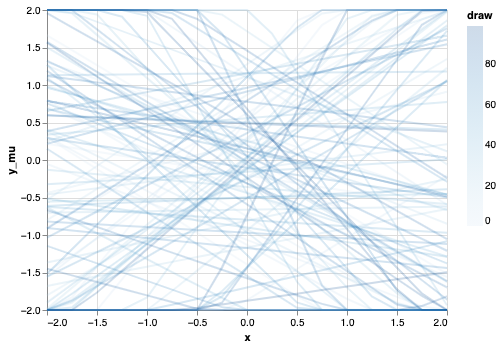

In [1239]:
alt.Chart(lines_df).mark_line(opacity=0.2).encode(
    x='x',
    y=alt.Y('y_mu', scale=alt.Scale(domain=[-2,2], clamp=True)),
    color='draw'
)

In [1240]:
x_ppc = np.arange(-2,2.25,.25)

data = {
    'Ny_ppc':50,
    'Nx_ppc':len(x_ppc),
    'x':x_ppc,
    'a_loc':0,
    'a_scale':0.2,
    'b_loc':0,
    'b_scale':0.5,
    'sigma_rate':1
}

In [1241]:
fit_prior = stan_model.sample(data=data, iter_sampling=100, fixed_param=True)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:finish chain 1


In [1242]:
azdata = az.from_cmdstanpy(
    prior=fit_prior, 
    prior_predictive=['y'],
    observed_data=data
)
samp_priors_df = azdata.prior.to_dataframe().reset_index()

# for the prior predictive check, we're joining in all of the samples to have a complete
# dataset to work with
samp_prior_pred_df = azdata.prior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':x_ppc})
temp['y_dim_1'] = temp.index.values
samp_prior_pred_df = pd.merge(samp_prior_pred_df, temp, how='left', on='y_dim_1')
samp_prior_pred_df = pd.merge(samp_prior_pred_df, samp_priors_df, how='left', on=['chain', 'draw'])

In [1243]:
az.summary(azdata)

arviz - WARNING - Shape validation failed: input_shape: (1, 100), minimum_shape: (chains=2, draws=4)


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.008,0.201,-0.377,0.338,0.024,0.017,68.0,68.0,78.0,100.0,NaN
b,0.074,0.509,-0.727,1.163,0.049,0.035,108.0,108.0,111.0,108.0,NaN
sigma,1.035,0.901,0.013,2.816,0.090,0.064,101.0,101.0,102.0,91.0,NaN


In [1244]:
lines_df = samp_prior_pred_df.groupby(['chain', 'draw', 'y_dim_1']).mean().reset_index().rename(
    {'y':'y_mean'}, axis=1).drop(['y_dim_1'], axis=1)
lines_df['y_std'] = samp_prior_pred_df.groupby(['chain', 'draw', 'y_dim_1']).y.std().values
lines_df['y_mu'] = lines_df.a + lines_df.b*lines_df.x

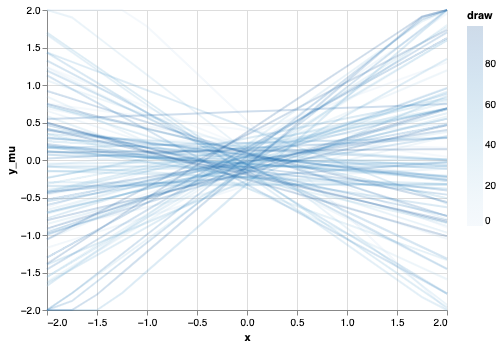

In [1245]:
alt.Chart(lines_df).mark_line(opacity=0.2).encode(
    x='x',
    y=alt.Y('y_mu', scale=alt.Scale(domain=[-2,2], clamp=True)),
    color='draw'
)

### Build the model

#### Define the model

This is the same generic gaussian model as in section 5.2 above.

In [1247]:
model_file = "./stan_artifacts/model_milk.stan"

In [1248]:
model_code = """
data {
  int<lower=1> N_obs;        // number of observations in data
  int<lower=1> K;            // number of predictors
  int<lower=1> Nx_ppc;       // number of predictor values for ppc
  int<lower=1> Ny_ppc;       // number of samples for target in ppc
  matrix[N_obs, K] x;        // predictor matrix
  vector[N_obs] y;           // target
  matrix[Nx_ppc, K] x_ppc;   // predictor matrix for ppc
}
parameters {
  real a;                // intercept
  vector[K] b;           // coefficients for predictors
  real<lower=0> sigma;   // target uncertainty
}
model {
  a ~ normal(0, 0.2);
  b ~ normal(0, 0.5);
  sigma ~ exponential(1);
  y ~ normal(a + x * b, sigma);
}
generated quantities {
  real y_ppc[Ny_ppc, Nx_ppc];
  for (i in 1:Ny_ppc) {
    y_ppc[i] = normal_rng(a + x_ppc * b, sigma);
  }
}
"""
with open(model_file, "w") as f:
    print(model_code, file=f)

In [1249]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk


#### Model m5_5 (neocortex percent as single predictor)

In [1259]:
x = np.transpose([data_df.N.values]).tolist()
x_ppc = np.transpose([np.arange(-3, 3.25, 0.25)]).tolist()
y = list(data_df.K.values)

data_m5_5 = {
    'N_obs': len(data_df),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 50,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [1260]:
fit_m5_5 = stan_model.sample(data=data_m5_5, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 4
INFO:cmdstanpy:finish chain 3


In [1261]:
azdata_m5_5 = az.from_cmdstanpy(
    posterior = fit_m5_5, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [1262]:
sum5_5 = az.summary(azdata_m5_5)
sum5_5

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.003,0.158,-0.312,0.278,0.003,0.004,2187.0,786.0,2189.0,1109.0,1.00
b[0],0.123,0.236,-0.298,0.599,0.006,0.005,1456.0,1253.0,1472.0,1385.0,1.01
sigma,1.048,0.199,0.708,1.399,0.005,0.004,1545.0,1437.0,1699.0,1389.0,1.00


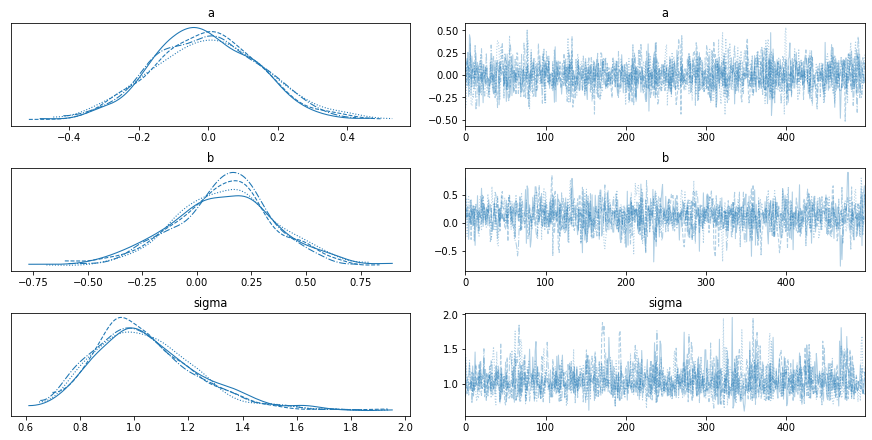

In [1263]:
az.plot_trace(azdata_m5_5)

plt.show()

In [1264]:
samp_post_df = azdata_m5_5.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_5.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':[x[0] for x in x_ppc]})
temp['y_ppc_dim_1'] = temp.index.values
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [1265]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

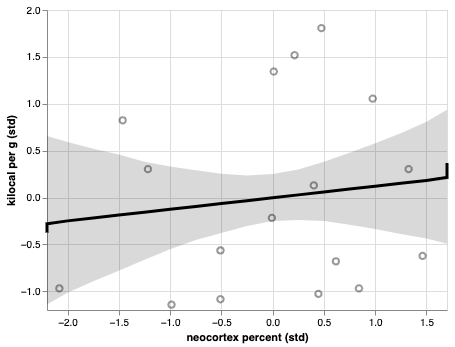

In [1273]:
temp = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
temp['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(data_df).mark_point(size=40, opacity=0.4, color='black').encode(
    alt.X('N:Q', title='neocortex percent (std)', scale=alt.Scale(nice=False, domain=[-2.2, 1.7], clamp=True)),
    alt.Y('K:Q', title='kilocal per g (std)', scale=alt.Scale(nice=False, domain=[-1.2, 2], clamp=True))
)

line = alt.Chart(temp).mark_line(size=3, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu'),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_ppc_mu_lower:Q',
    y2='y_ppc_mu_upper:Q'
)

points+area+line

#### Model m5_6 (log mass as single predictor)

In [1276]:
x = np.transpose([data_df.M.values]).tolist()
x_ppc = np.transpose([np.arange(-3, 3.25, 0.25)]).tolist()
y = list(data_df.K.values)

data_m5_6 = {
    'N_obs': len(data_df),
    'K': 1,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 50,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [1277]:
fit_m5_6 = stan_model.sample(data=data_m5_6, iter_sampling=500, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 3
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 4


In [1278]:
azdata_m5_6 = az.from_cmdstanpy(
    posterior = fit_m5_6, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x': x, 'y': y}
)

In [1279]:
sum5_6 = az.summary(azdata_m5_6)
sum5_6

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.001,0.153,-0.278,0.295,0.004,0.003,1854.0,1041.0,1852.0,1294.0,1.0
b[0],-0.282,0.211,-0.685,0.116,0.005,0.004,1743.0,1451.0,1768.0,1154.0,1.0
sigma,0.993,0.187,0.653,1.297,0.005,0.004,1289.0,1108.0,1672.0,1102.0,1.0


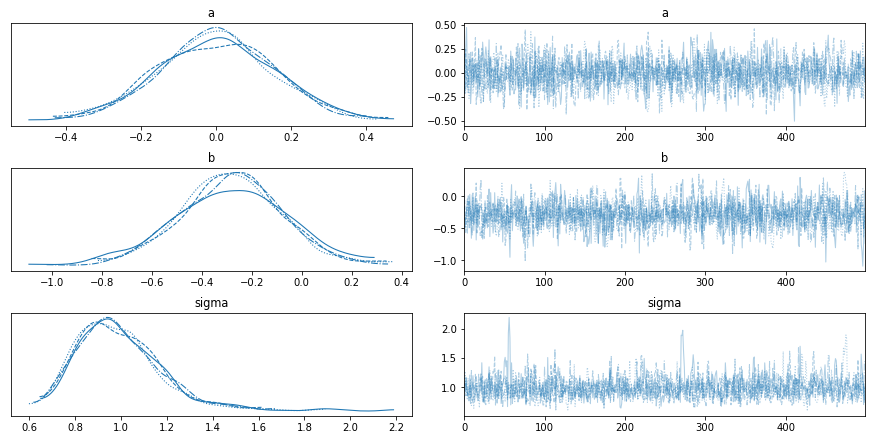

In [1280]:
az.plot_trace(azdata_m5_6)

plt.show()

In [1281]:
samp_post_df = azdata_m5_6.posterior.to_dataframe().reset_index()
samp_post_pred_df = azdata_m5_6.posterior_predictive.to_dataframe().reset_index()
temp = pd.DataFrame({'x':[x[0] for x in x_ppc]})
temp['y_ppc_dim_1'] = temp.index.values
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

In [1282]:
lines_df = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).mean().reset_index().rename({'y_ppc':'y_ppc_mean'}, axis=1)
lines_df['y_ppc_std'] = samp_post_pred_df.groupby(['chain', 'draw', 'y_ppc_dim_1']).y_ppc.std().values
lines_df['y_ppc_mu'] = lines_df.a + lines_df.b*lines_df.x

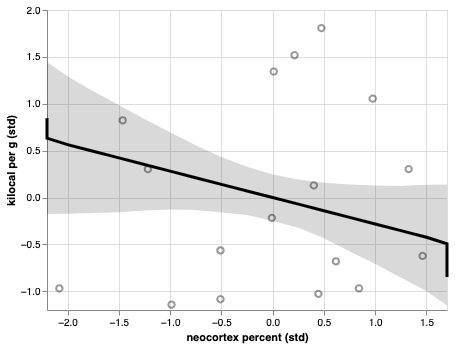

In [1283]:
temp = lines_df.groupby('y_ppc_dim_1').mean().reset_index()
temp['y_ppc_mu_lower'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.055).values
temp['y_ppc_mu_upper'] = lines_df.groupby('y_ppc_dim_1').y_ppc_mu.quantile(0.945).values

points = alt.Chart(data_df).mark_point(size=40, opacity=0.4, color='black').encode(
    alt.X('N:Q', title='neocortex percent (std)', scale=alt.Scale(nice=False, domain=[-2.2, 1.7], clamp=True)),
    alt.Y('K:Q', title='kilocal per g (std)', scale=alt.Scale(nice=False, domain=[-1.2, 2], clamp=True))
)

line = alt.Chart(temp).mark_line(size=3, color='black').encode(
    x=alt.X('x'),
    y=alt.Y('y_ppc_mu'),
)

area = alt.Chart(temp).mark_area(opacity=0.15, color='black').encode(
    x='x:Q',
    y='y_ppc_mu_lower:Q',
    y2='y_ppc_mu_upper:Q'
)

points+area+line

#### Model m5_7 (including both predictors)

In [1353]:
x = np.transpose([data_df.N.values, data_df.M.values]).tolist()
# for our posterior predictions, we first consider M=0, then N=0
x0 = np.arange(-3, 3.25, 0.25)
x_ppc = np.array([[xi, 0.0] for xi in x0] + [[0.0, xi] for xi in x0])
y = list(data_df.K.values)

data_m5_7 = {
    'N_obs': len(data_df),
    'K': 2,
    'Nx_ppc': len(x_ppc),
    'Ny_ppc': 50,
    'x': x,
    'y': y,
    'x_ppc': x_ppc
}

In [1354]:
fit_m5_7 = stan_model.sample(data=data_m5_7, iter_sampling=1000, iter_warmup=500, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 3
INFO:cmdstanpy:finish chain 4


In [1355]:
azdata_m5_7 = az.from_cmdstanpy(
    posterior = fit_m5_7, 
    posterior_predictive = ['y_ppc'],
    observed_data = {'x':x, 'y':y}
)

In [1356]:
sum5_7 = az.summary(azdata_m5_7)
sum5_7

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a,-0.000,0.134,-0.256,0.246,0.002,0.002,3513.0,2102.0,3517.0,2923.0,1.0
b[0],0.579,0.261,0.104,1.067,0.005,0.004,2307.0,2293.0,2305.0,2855.0,1.0
b[1],-0.682,0.264,-1.153,-0.180,0.005,0.004,2327.0,2327.0,2359.0,2808.0,1.0
sigma,0.806,0.166,0.533,1.120,0.003,0.002,2352.0,2274.0,2453.0,2441.0,1.0


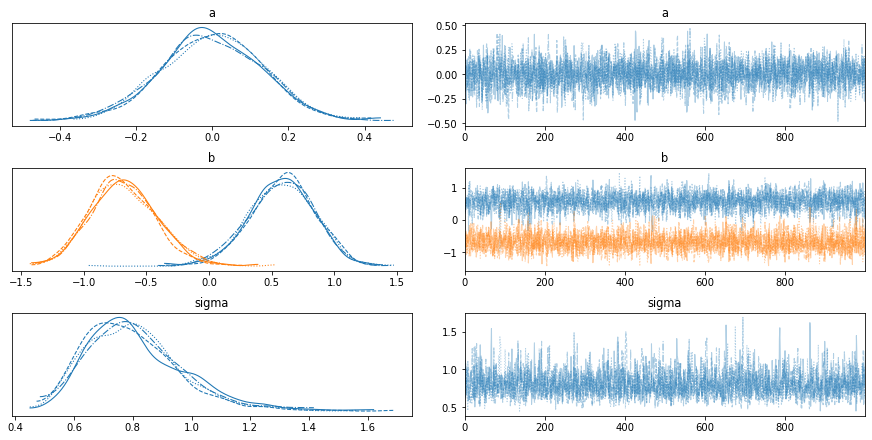

In [1357]:
az.plot_trace(azdata_m5_7)

plt.show()

In [1358]:
bcompare_df = pd.DataFrame({
    'model':['bN_m5.5', 'bN_m5.6', 'bN_m5.7', 'bM_m5.5', 'bM_m5.6', 'bM_m5.7'],
    'value':[sum5_5.loc['b[0]']['mean'], np.nan, sum5_7.loc['b[0]']['mean'], np.nan, sum5_6.loc['b[0]']['mean'], sum5_7.loc['b[1]']['mean']],
    'low':[sum5_5.loc['b[0]']['hdi_3%'], np.nan, sum5_7.loc['b[0]']['hdi_3%'], np.nan, sum5_6.loc['b[0]']['hdi_3%'], sum5_7.loc['b[1]']['hdi_3%']],
    'high':[sum5_5.loc['b[0]']['hdi_97%'], np.nan, sum5_7.loc['b[0]']['hdi_97%'], np.nan, sum5_6.loc['b[0]']['hdi_97%'], sum5_7.loc['b[1]']['hdi_97%']]
})
bcompare_df['zero'] = 0

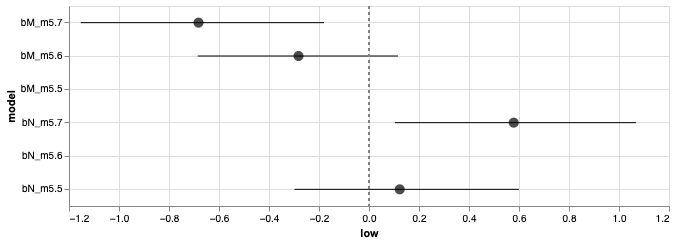

In [1359]:
c1 = alt.Chart(bcompare_df).mark_circle(color='black', size=100).encode(
    x=alt.X('value:Q', scale=alt.Scale(domain=[-1.2, 1.2], nice=False)),
    y=alt.Y('model:N',
            axis=alt.Axis(grid=True),
            scale=alt.Scale(domain=['bM_m5.7', 'bM_m5.6', 'bM_m5.5', 'bN_m5.7', 'bN_m5.6', 'bN_m5.5']))
).properties(
    width=600,
    height=200
)

c2 = alt.Chart(bcompare_df).mark_errorbar().encode(
    x="low:Q",
    x2="high:Q",
    y="model:N",
)

c3 = alt.Chart().mark_rule(color='gray',strokeDash=[3,3]).encode(x='zero')

c1+c2+c3

In the above plot (see page 150), we see that when including both age at predictors, the association of each variable is increased compared to when they are each treated alone.

In [1360]:
# the unstack pivots coefs to columns; a and sigma columns are scalar
samp_post_df = azdata_m5_7.posterior.to_dataframe().unstack(level=0).reset_index().rename_axis((None,None), axis=1)
samp_post_df.columns = ['_'.join([str(c) for c in col]).strip('_') for col in samp_post_df.columns]
samp_post_df.drop(['a_1','sigma_1'], inplace=True, axis=1)
samp_post_df.rename(columns={'a_0':'a', 'sigma_0':'sigma'}, inplace=True)

samp_post_pred_df = azdata_m5_7.posterior_predictive.to_dataframe().reset_index()
samp_post_pred_df = pd.merge(samp_post_pred_df, samp_post_df, how='left', on=['chain', 'draw'])

temp = pd.DataFrame({'x_0':[x[0] for x in x_ppc], 'x_1':[x[1] for x in x_ppc]})
temp['y_ppc_dim_1'] = temp.index.values
samp_post_pred_df = pd.merge(samp_post_pred_df, temp, how='left', on='y_ppc_dim_1')
samp_post_pred_df['mu'] = samp_post_pred_df.pipe(lambda x: x.a + x.b_0*x.x_0 + x.b_1*x.x_1)

temp = samp_post_pred_df[samp_post_pred_df.x_1==0]
preds_N = temp.groupby(['y_ppc_dim_1']).mean().reset_index().rename({'y_ppc': 'y_pred_mean'}, axis=1)
preds_N['y_pred_low'] = temp.groupby(['y_ppc_dim_1']).y_ppc.quantile(0.055).values
preds_N['y_pred_high'] = temp.groupby(['y_ppc_dim_1']).y_ppc.quantile(0.945).values
preds_N['mu_low'] = temp.groupby(['y_ppc_dim_1']).mu.quantile(0.055).values
preds_N['mu_high'] = temp.groupby(['y_ppc_dim_1']).mu.quantile(0.945).values

temp = samp_post_pred_df[samp_post_pred_df.x_0==0]
preds_M = temp.groupby(['y_ppc_dim_1']).mean().reset_index().rename({'y_ppc': 'y_pred_mean'}, axis=1)
preds_M['y_pred_low'] = temp.groupby(['y_ppc_dim_1']).y_ppc.quantile(0.055).values
preds_M['y_pred_high'] = temp.groupby(['y_ppc_dim_1']).y_ppc.quantile(0.945).values
preds_M['mu_low'] = temp.groupby(['y_ppc_dim_1']).mu.quantile(0.055).values
preds_M['mu_high'] = temp.groupby(['y_ppc_dim_1']).mu.quantile(0.945).values

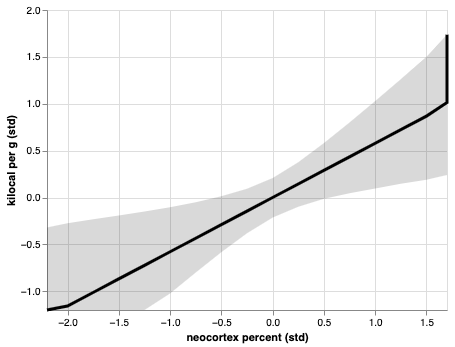

In [1361]:
line = alt.Chart(preds_N).mark_line(size=3, color='black').encode(
    x=alt.X('x_0:Q', title='neocortex percent (std)', scale=alt.Scale(domain=[-2.2, 1.7], nice=False, clamp=True)),
    y=alt.Y('mu', title='kilocal per g (std)', scale=alt.Scale(domain=[-1.2, 2], nice=False, clamp=True)),
)

area = alt.Chart(preds_N).mark_area(opacity=0.15, color='black').encode(
    x='x_0:Q',
    y='mu_low:Q',
    y2='mu_high:Q'
)

area+line

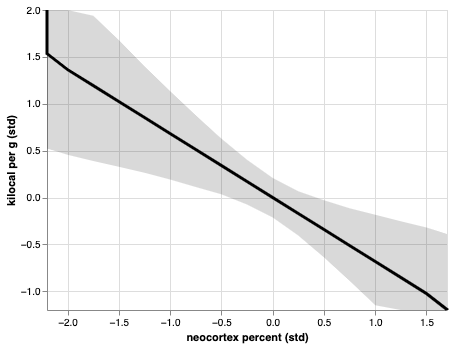

In [1362]:
line = alt.Chart(preds_M).mark_line(size=3, color='black').encode(
    x=alt.X('x_1:Q', title='neocortex percent (std)', scale=alt.Scale(domain=[-2.2, 1.7], nice=False, clamp=True)),
    y=alt.Y('mu', title='kilocal per g (std)', scale=alt.Scale(domain=[-1.2, 2], nice=False, clamp=True)),
)

area = alt.Chart(preds_M).mark_area(opacity=0.15, color='black').encode(
    x='x_1:Q',
    y='mu_low:Q',
    y2='mu_high:Q'
)

area+line

## Chapter 5.3: Categorical Variables

indexed variables in stan: https://stackoverflow.com/questions/29183577/how-to-represent-a-categorical-predictor-rstan/29184649

### Binary category

#### Data

In [1414]:
# this is the dataset used in Ch. 4 of Statistical Rethinking.
data_df = pd.read_csv('https://raw.githubusercontent.com/rmcelreath/rethinking/master/data/Howell1.csv', sep=';')
# data_df = data_df[data_df.age>=18] # select adults
data_df['sex'] = data_df.male.values + 1
heights = data_df.height.values
sex = data_df.sex.values

In [1415]:
data_df.head()

,height,weight,age,male,sex
0,151.765,47.825606,63.0,1,2
1,139.700,36.485807,63.0,0,1
2,136.525,31.864838,65.0,0,1
3,156.845,53.041914,41.0,1,2
4,145.415,41.276872,51.0,0,1


#### Fitting the posterior

In [1416]:
model_file = "./stan_artifacts/model_height_sex.stan"

In [1417]:
model_code = """
data {
  int<lower=1> N_obs;
  real height[N_obs];
  int sex[N_obs];
}
parameters {
  vector[2] a;
  real<lower=0> sigma;
}
transformed parameters {
  vector[N_obs] mu;
  mu = a[sex];
}
model {
  a[1] ~ normal(178, 20);
  a[2] ~ normal(178, 20);
  sigma ~ lognormal(1, 1);
  height ~ normal(mu, sigma);
}
generated quantities {
  real diff_fm;
  diff_fm = a[1] - a[2];
}
"""

with open(model_file, "w") as f:
    print(model_code, file=f)

In [1418]:
data = {
    'N_obs':len(heights),
    'height':heights,
    'sex':sex
}

In [1419]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height_sex
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height_sex
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_height_sex


In [1420]:
fit = stan_model.sample(data=data, iter_sampling=1000, iter_warmup=1000, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 4
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 3
INFO:cmdstanpy:finish chain 1


In [1421]:
azdata = az.from_cmdstanpy(
    posterior=fit, 
    observed_data={"height": data["height"], "sex": data["sex"]}
)
samp_post_df = azdata.posterior.to_dataframe().reset_index()

In [1422]:
az.summary(azdata, var_names=['a', 'sigma', 'diff_fm'])

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat
a[0],134.892,1.646,131.856,138.027,0.026,0.019,3945.0,3945.0,3951.0,2760.0,1.0
a[1],142.570,1.657,139.591,145.747,0.026,0.018,4080.0,4076.0,4084.0,3205.0,1.0
sigma,27.327,0.852,25.773,28.965,0.014,0.010,3733.0,3715.0,3749.0,2991.0,1.0
diff_fm,-7.678,2.326,-12.030,-3.227,0.037,0.026,4049.0,3992.0,4052.0,2837.0,1.0


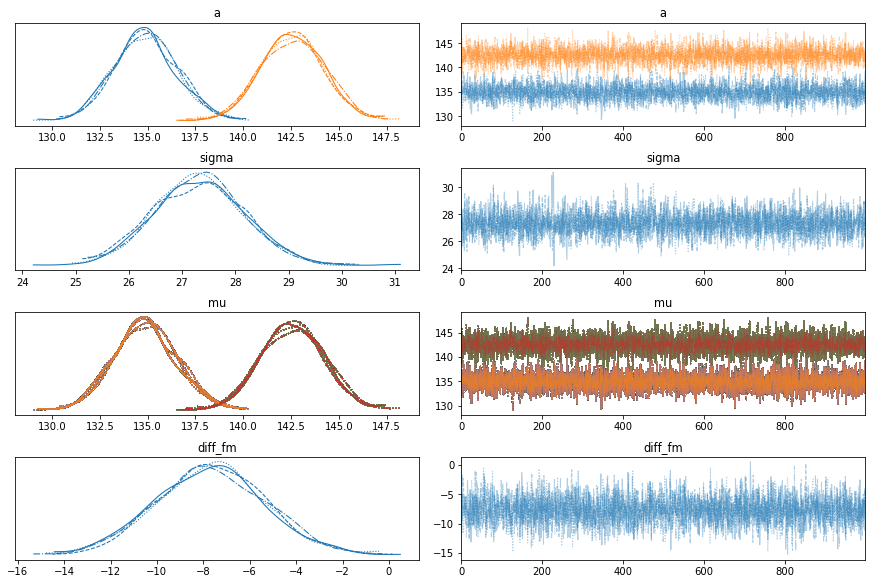

In [1423]:
az.plot_trace(azdata)

plt.show()

### Many categories

### Data

In [1477]:
data_df = pd.read_csv('https://raw.githubusercontent.com/rmcelreath/rethinking/master/data/milk.csv', sep=';')
data_df = data_df[['clade', 'species', 'kcal.per.g']].copy()
# 'complete case analysis': drop rows with any missing values
data_df.dropna(inplace=True)
data_df.reset_index(inplace=True, drop=True)
# define standardized variables and take the log of mass
data_df['K'] = data_df['kcal.per.g'].pipe(lambda x: (x - x.mean()) / x.std())

clade_cats = {
    'Ape':1,
    'New World Monkey':2,
    'Old World Monkey':3,
    'Strepsirrhine':4
}
data_df['clade_index'] = [clade_cats[c] for c in data_df.clade]
data_df.head()

,clade,species,kcal.per.g,K,clade_index
0,Strepsirrhine,Eulemur fulvus,0.49,-0.940041,4
1,Strepsirrhine,E macaco,0.51,-0.816126,4
2,Strepsirrhine,E mongoz,0.46,-1.125913,4
3,Strepsirrhine,E rubriventer,0.48,-1.001998,4
4,Strepsirrhine,Lemur catta,0.60,-0.258511,4


#### Fitting the posterior

In [1478]:
model_file = "./stan_artifacts/model_milk_clade.stan"

In [1468]:
model_code = """
data {
  int<lower=1> N_obs;
  real K[N_obs];
  int clade_index[N_obs];
}
parameters {
  vector[4] a;
  real<lower=0> sigma;
}
transformed parameters {
  vector[N_obs] mu;
  mu = a[clade_index];
}
model {
  a ~ normal(0, .5);
  sigma ~ lognormal(1, 1);
  K ~ normal(mu, sigma);
}
"""

with open(model_file, "w") as f:
    print(model_code, file=f)

In [1479]:
data = {
    'N_obs':len(data_df),
    'K':data_df.K.values,
    'clade_index':data_df.clade_index.values
}

In [1470]:
stan_model = cmdstanpy.CmdStanModel(stan_file=model_file)
stan_model.compile()

INFO:cmdstanpy:compiling stan program, exe file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk_clade
INFO:cmdstanpy:compiler options: stanc_options=None, cpp_options=None
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk_clade
INFO:cmdstanpy:found newer exe file, not recompiling
INFO:cmdstanpy:compiled model file: /Users/jamieinfinity/Dropbox/Projects/twimlai/prob_prog/bayesian/stan_artifacts/model_milk_clade


In [1480]:
fit = stan_model.sample(data=data, iter_sampling=1000, iter_warmup=1000, chains=4)

INFO:cmdstanpy:start chain 1
INFO:cmdstanpy:start chain 2
INFO:cmdstanpy:start chain 3
INFO:cmdstanpy:start chain 4
INFO:cmdstanpy:finish chain 1
INFO:cmdstanpy:finish chain 2
INFO:cmdstanpy:finish chain 3
INFO:cmdstanpy:finish chain 4


In [1481]:
azdata = az.from_cmdstanpy(
    posterior=fit, 
    observed_data={"K": data["K"], "clade_index": data["clade_index"]}
)
samp_post_df = azdata.posterior.to_dataframe().reset_index()

In [1485]:
param_summary = az.summary(azdata, var_names=['a', 'sigma'])
param_summary['param'] = param_summary.index
param_summary

,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_mean,ess_sd,ess_bulk,ess_tail,r_hat,param
a[0],-0.458,0.250,-0.912,0.019,0.004,0.003,4952.0,4234.0,4952.0,3272.0,1.0,a[0]
a[1],0.342,0.242,-0.114,0.788,0.004,0.003,4476.0,3580.0,4559.0,2828.0,1.0,a[1]
a[2],0.623,0.289,0.089,1.156,0.004,0.003,4341.0,4341.0,4465.0,2578.0,1.0,a[2]
a[3],-0.541,0.308,-1.162,0.007,0.004,0.003,4786.0,4377.0,4805.0,3183.0,1.0,a[3]
sigma,0.822,0.123,0.596,1.036,0.002,0.002,3282.0,3143.0,3421.0,2920.0,1.0,sigma


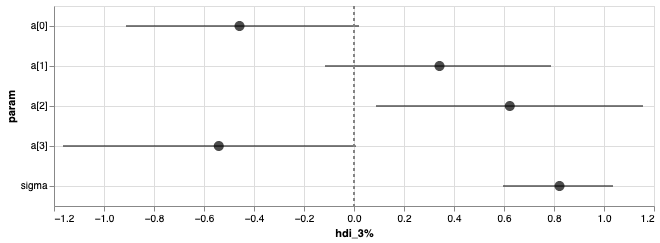

In [1500]:
temp = param_summary
temp['zero'] = 0

c1 = alt.Chart(temp).mark_circle(color='black', size=100).encode(
    x=alt.X('mean:Q'),
    y=alt.Y('param:N', axis=alt.Axis(grid=True))
).properties(
    width=600,
    height=200
)

c2 = alt.Chart(temp).mark_errorbar().encode(
    x="hdi_3%:Q",
    x2="hdi_97%:Q",
    y="param:N",
)

c3 = alt.Chart().mark_rule(color='gray',strokeDash=[3,3]).encode(x='zero')

c1+c2+c3

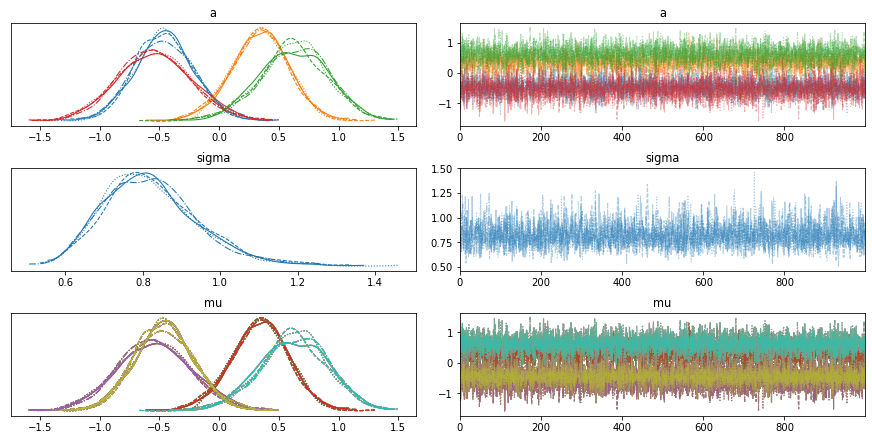

In [1483]:
az.plot_trace(azdata)

plt.show()